In [1]:
# PART -01 THIS IS THE CODE TO DOWNLOAD THE DATA 
import os
import urllib.request
import zipfile

def download_eeg_zip(url, save_dir):
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)
    else:
        raise FileExistsError('Directory already exists',save_dir)

    file_name = url.split('/')[-1]
    file_path = os.path.join(save_dir, file_name)

    print("Downloading EEG zip file from:", url)
    urllib.request.urlretrieve(url, file_path)
    print("Download complete!")

    return file_path

eeg_zip_url = "https://physionet.org/static/published-projects/eegmmidb/eeg-motor-movementimagery-dataset-1.0.0.zip"


save_directory = "./EEG_Data"


downloaded_file_path = download_eeg_zip(eeg_zip_url, save_directory)

with zipfile.ZipFile(downloaded_file_path, 'r') as zip_ref:
    print("Extracting files...")
    zip_ref.extractall(save_directory)
    print("Extraction complete!")

print("EEG data has been downloaded and extracted to:", save_directory)


FileExistsError: [Errno Directory already exists] ./EEG_Data

In [1]:

import pyforest
import mne
import matplotlib.pyplot as plt
import pathlib
from glob import glob

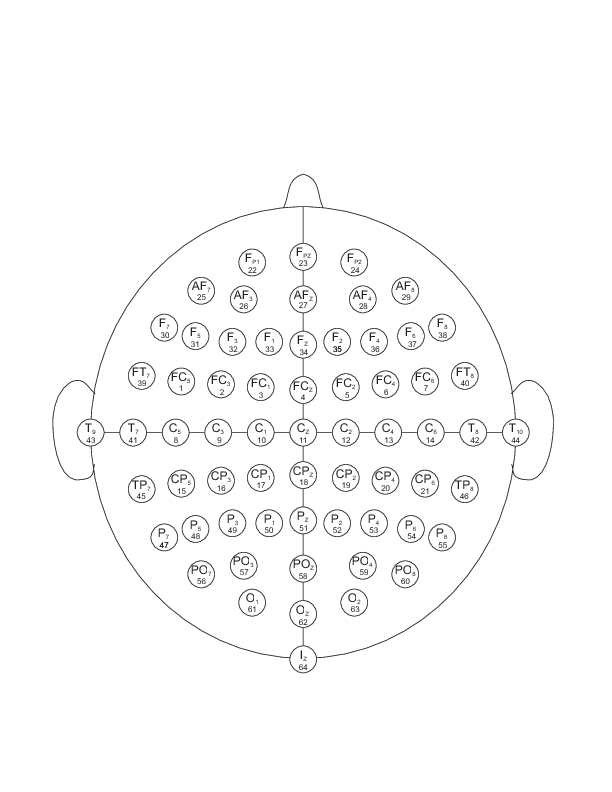

In [2]:
dir='EEG_DATA/64_channel_sharbrough-old.png'
from IPython.display import Image
Image(filename=dir)


These are all of the electrodes position over the lobes.
From where the readings have been taken

In [4]:
all_file_path =glob('EEG_data\*.edf')

In [5]:
print(all_file_path)

[]


In [3]:
person_1_path_list=glob('EEG_data/S001/*.edf')

In [14]:
person_1_path_list[0]

'EEG_data/S001\\S001R01.edf'

In [15]:
print(person_1_path_list)

['EEG_data/S001\\S001R01.edf', 'EEG_data/S001\\S001R02.edf', 'EEG_data/S001\\S001R03.edf', 'EEG_data/S001\\S001R04.edf', 'EEG_data/S001\\S001R05.edf', 'EEG_data/S001\\S001R06.edf', 'EEG_data/S001\\S001R07.edf', 'EEG_data/S001\\S001R08.edf', 'EEG_data/S001\\S001R09.edf', 'EEG_data/S001\\S001R10.edf', 'EEG_data/S001\\S001R11.edf', 'EEG_data/S001\\S001R12.edf', 'EEG_data/S001\\S001R13.edf', 'EEG_data/S001\\S001R14.edf']


In [16]:
raw=mne.io.read_raw_edf(person_1_path_list[0],misc=['F7','F5'],preload=True)

Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R01.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 9759  =      0.000 ...    60.994 secs...


In [11]:
raw.filter(1,20)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 529 samples (3.306 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Measurement date,"August 12, 2009 16:15:00 GMT"
Experimenter,Unknown
Participant,X
Digitized points,Not available
Good channels,64 EEG
Bad channels,None
EOG channels,Not available
ECG channels,Not available
Sampling frequency,160.00 Hz
Highpass,1.00 Hz
Lowpass,20.00 Hz


Using matplotlib as 2D backend.


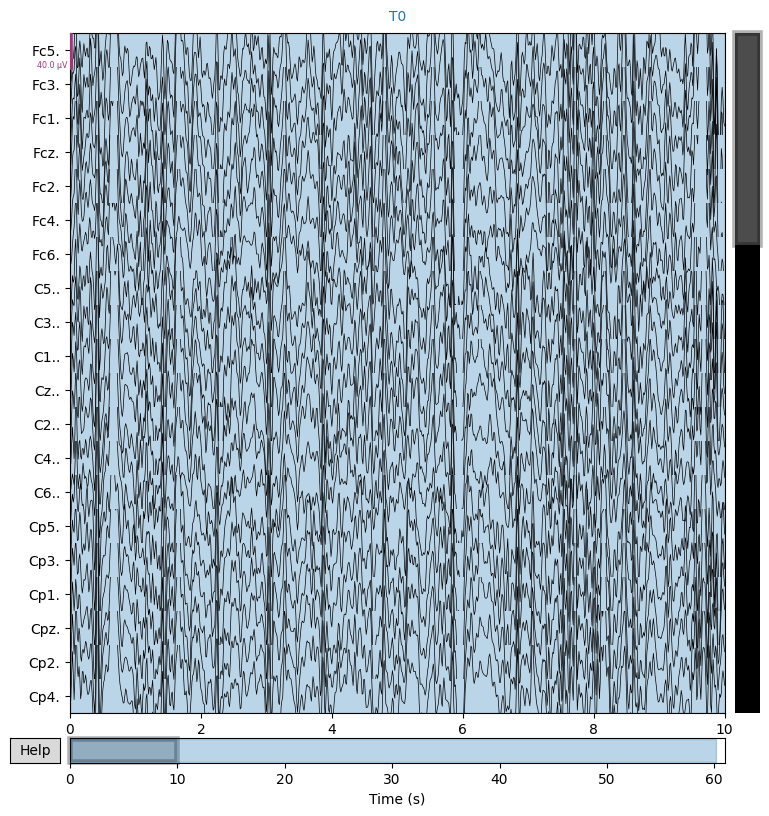

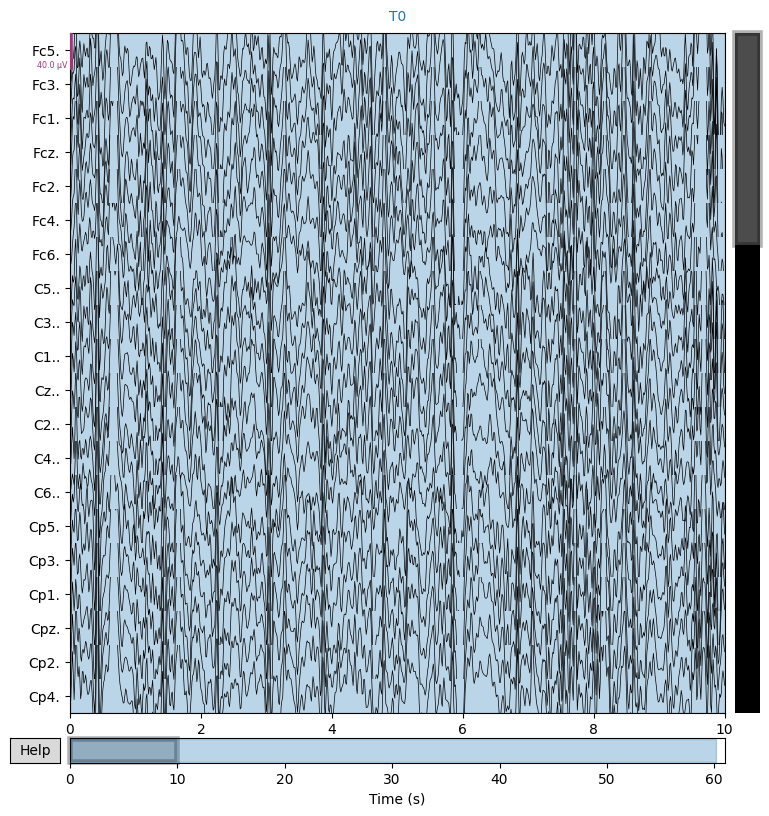

In [13]:
raw.plot()

In [6]:
# using preload=True
raw=mne.io.read_raw_edf(person_1_path_list[0],preload=True)


Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R01.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 9759  =      0.000 ...    60.994 secs...


In [18]:
raw.filter(1,70)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 70 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 70.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 75.00 Hz)
- Filter length: 529 samples (3.306 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Measurement date,"August 12, 2009 16:15:00 GMT"
Experimenter,Unknown
Participant,X
Digitized points,Not available
Good channels,64 EEG
Bad channels,None
EOG channels,Not available
ECG channels,Not available
Sampling frequency,160.00 Hz
Highpass,1.00 Hz
Lowpass,70.00 Hz


Using matplotlib as 2D backend.


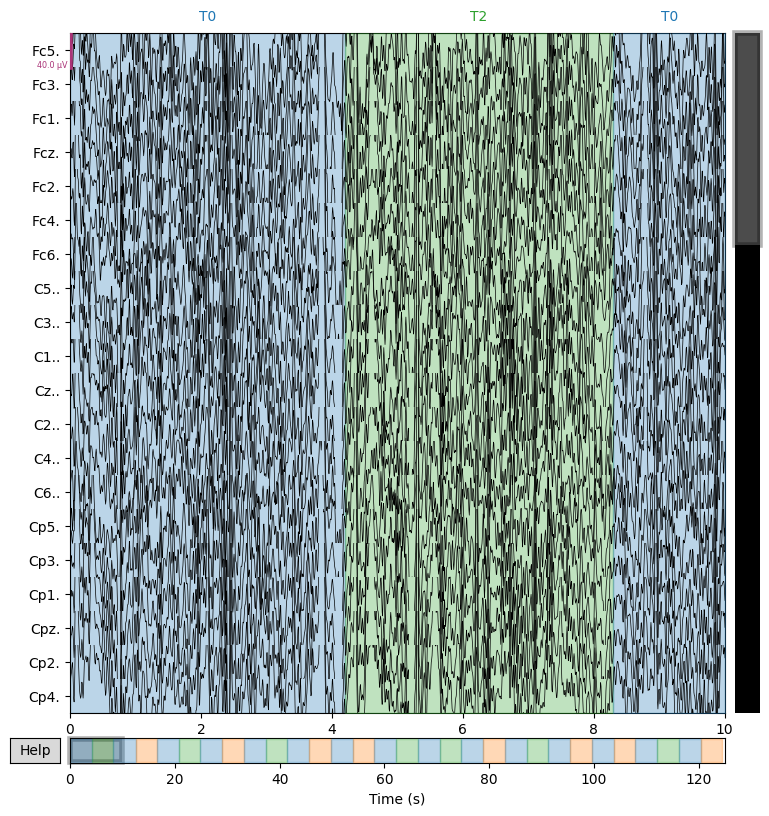

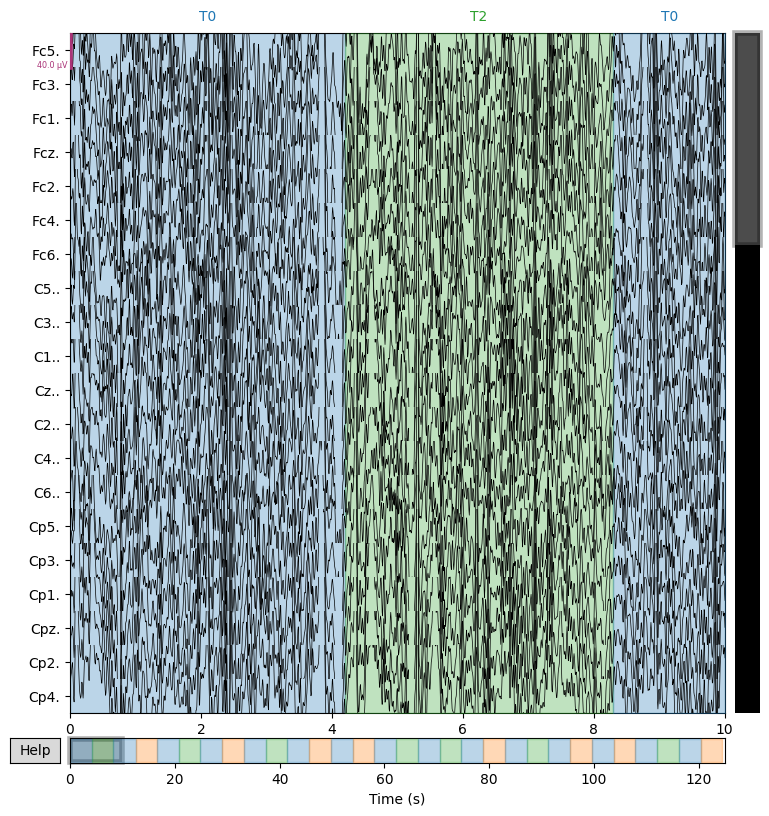

In [11]:
raw.plot()
# currently the raw is for first 20 seconds

In [12]:
raw.filter(0,5)

Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 5.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 6.00 Hz)
- Filter length: 265 samples (1.656 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Measurement date,"August 12, 2009 16:15:00 GMT"
Experimenter,Unknown
Participant,X
Digitized points,Not available
Good channels,64 EEG
Bad channels,None
EOG channels,Not available
ECG channels,Not available
Sampling frequency,160.00 Hz
Highpass,1.00 Hz
Lowpass,5.00 Hz


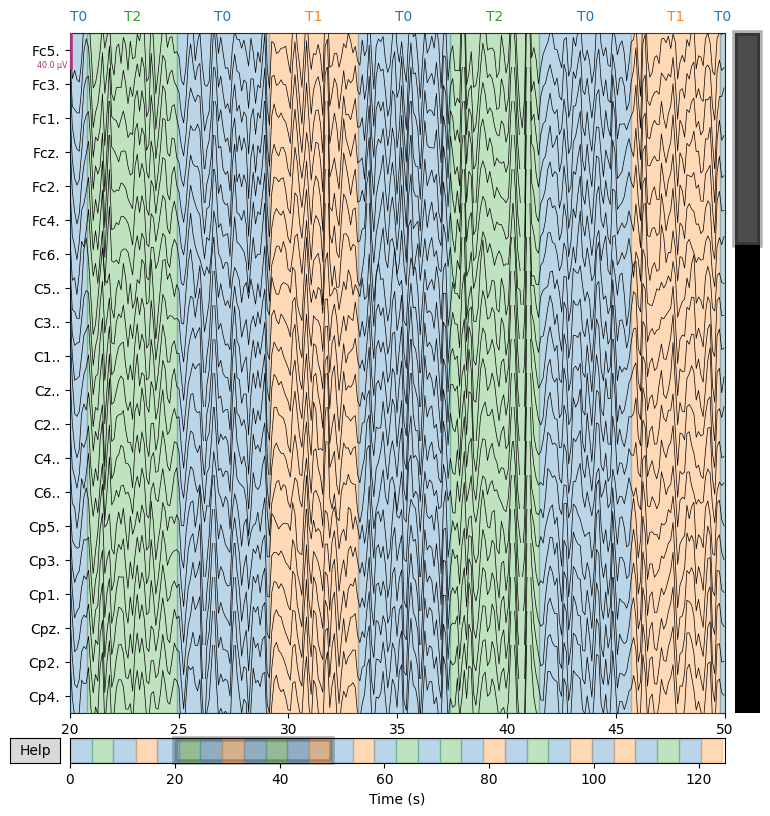

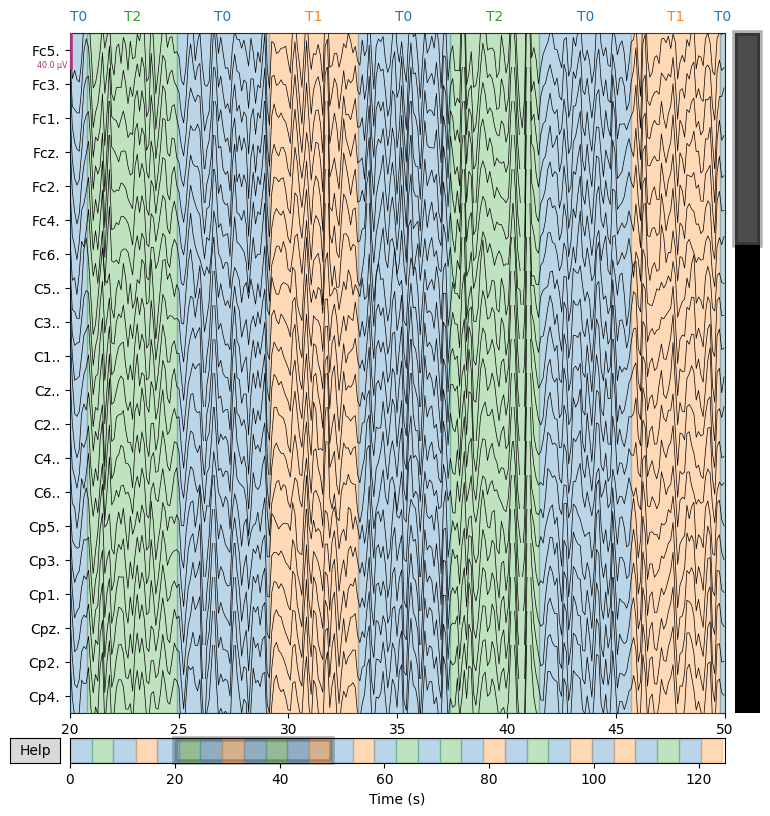

In [23]:
raw.plot(start=20,duration=30)

In [19]:
import sys
import contextlib

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 529 samples (3.306 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


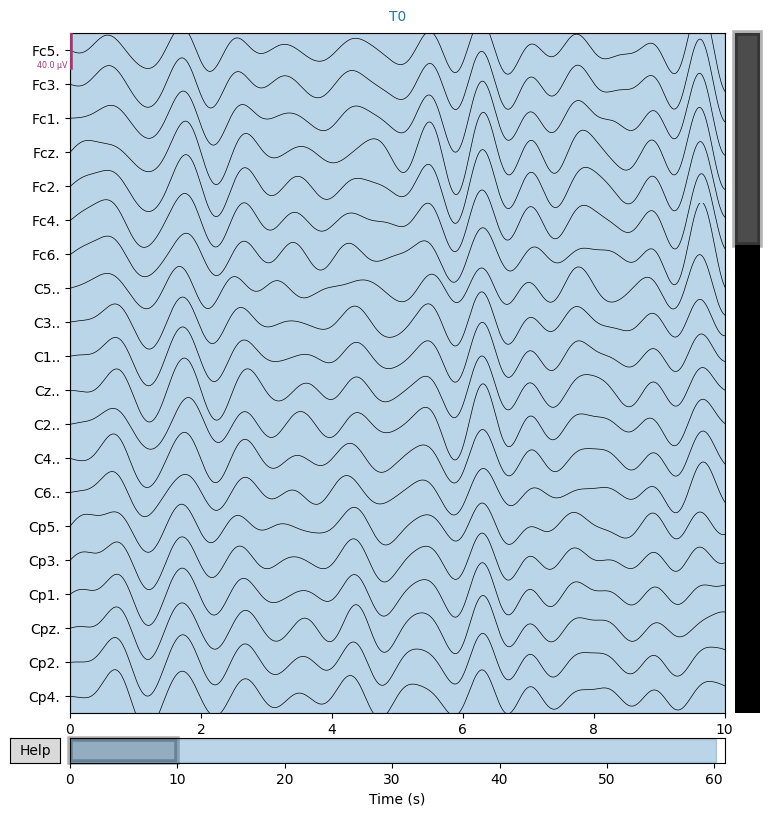

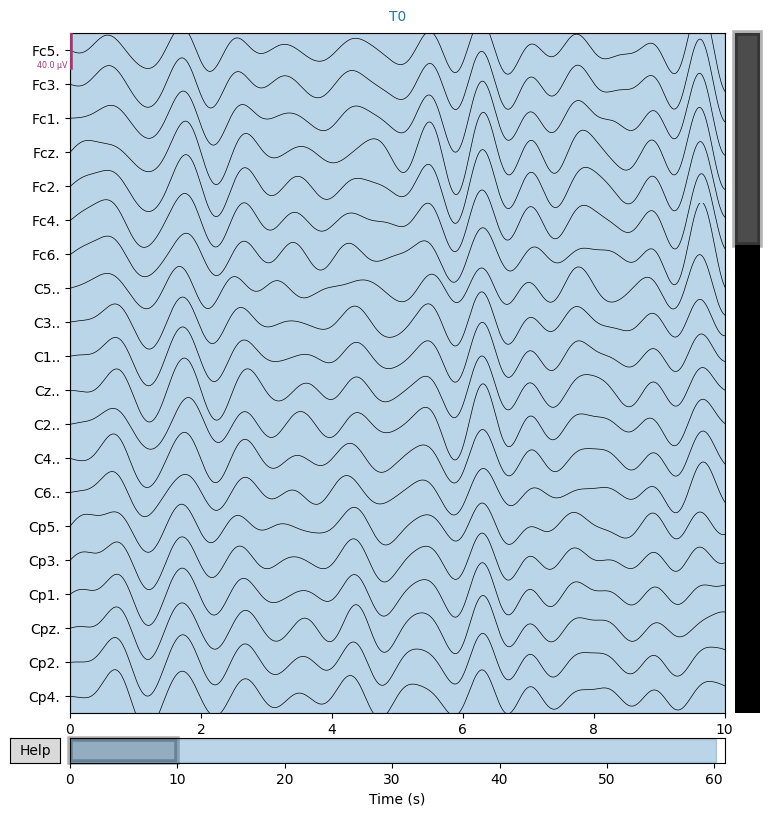

In [20]:
raw.filter(1,50)
raw.plot()

The data is segmented over an interval of around 60 seconds

In [21]:
@contextlib.contextmanager
def suppress_stdout():
    with open(os.devnull, 'w') as devnull:
        old_stdout = sys.stdout
        sys.stdout = devnull
        try:  
            yield
        finally:
            sys.stdout = old_stdout

In [22]:
def plot_function(file_path,low_frequency,high_frequency,info_needed=False,start_time=0,duration=50):
    '''
    This function will plot and filter the edf graph from low to the high frequency
    '''
    if(not info_needed):
        with suppress_stdout():
            raw = mne.io.read_raw_edf(file_path, preload=True)
            raw.filter(low_frequency, high_frequency)
            raw.plot(start=start_time,duration=duration);
    else:
        raw = mne.io.read_raw_edf(file_path, preload=True)
        raw.filter(low_frequency, high_frequency)
        raw.plot(start=start_time,duration=duration);
        
    

In [73]:
model.summary()

Model: "sequential_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1d_15 (Conv1D)              │ (None, 62, 64)         │        30,976 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_15 (MaxPooling1D) │ (None, 31, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_16 (Conv1D)              │ (None, 29, 128)        │        24,704 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_16 (MaxPooling1D) │ (None, 14, 128)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_17 (Conv1D)              │ (None, 12, 256)        │        98,560 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_17 (MaxPooling1D) │ (None, 6, 256)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_7 (Flatten)             │ (None, 1536)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_16 (Dense)                │ (None, 128)            │       196,736 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_17 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_18 (Dense)                │ (None, 3)              │           195 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,078,283 (4.11 MB)

 Trainable params: 359,427 (1.37 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 718,856 (2.74 MB)

In [23]:
task_description = {
    1: 'Baseline, eyes open',
    2: 'Baseline, eyes closed',
    3: 'Task 1 (open and close left or right fist)',
    4: 'Task 2 (imagine opening and closing left or right fist)',
    5: 'Task 3 (open and close both fists or both feet)',
    6: 'Task 4 (imagine opening and closing both fists or both feet)',
    7: 'Task 1',
    8: 'Task 2',
    9: 'Task 3',
    10: 'Task 4',
    11: 'Task 1',
    12: 'Task 2',
    13: 'Task 3',
    14: 'Task 4'
}




T0 corresponds to rest
<br>
T1 corresponds to onset of motion (real or imagined) of
<br>
the left fist (in runs 3, 4, 7, 8, 11, and 12)
<br>
both fists (in runs 5, 6, 9, 10, 13, and 14)
<br>
T2 corresponds to onset of motion (real or imagined) of
<br>
the right fist (in runs 3, 4, 7, 8, 11, and 12)
<br>
both feet (in runs 5, 6, 9, 10, 13, and 14)

PERSON1
Task Performed: Baseline, eyes open
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R01.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 9759  =      0.000 ...    60.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 3 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 3.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 4.00 Hz)
- Filter length: 529 samples (3.306 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


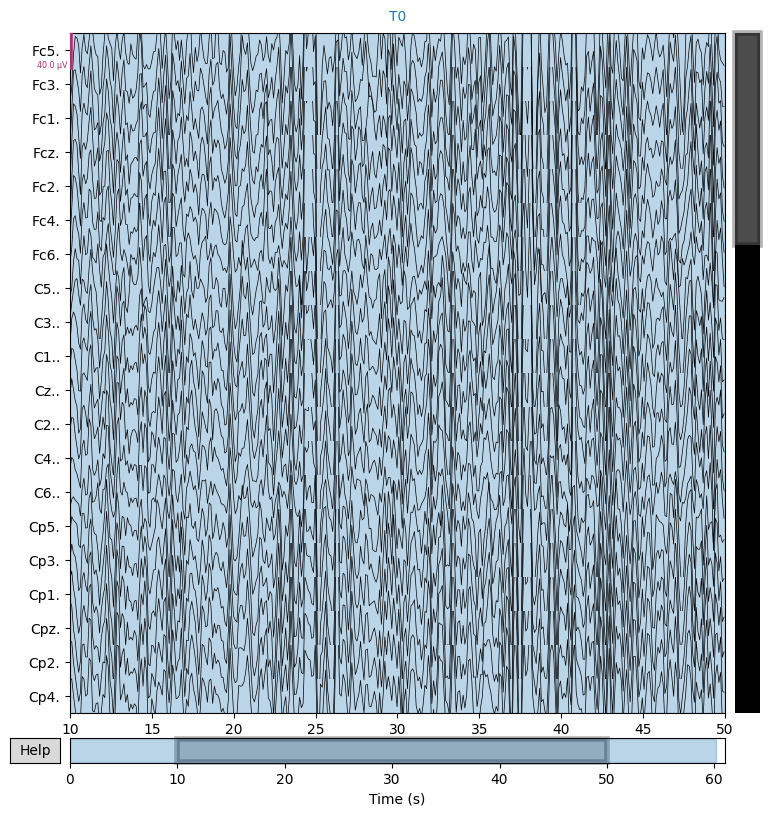

PERSON2
Task Performed: Baseline, eyes closed
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R02.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 9759  =      0.000 ...    60.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 3 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 3.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 4.00 Hz)
- Filter length: 529 samples (3.306 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


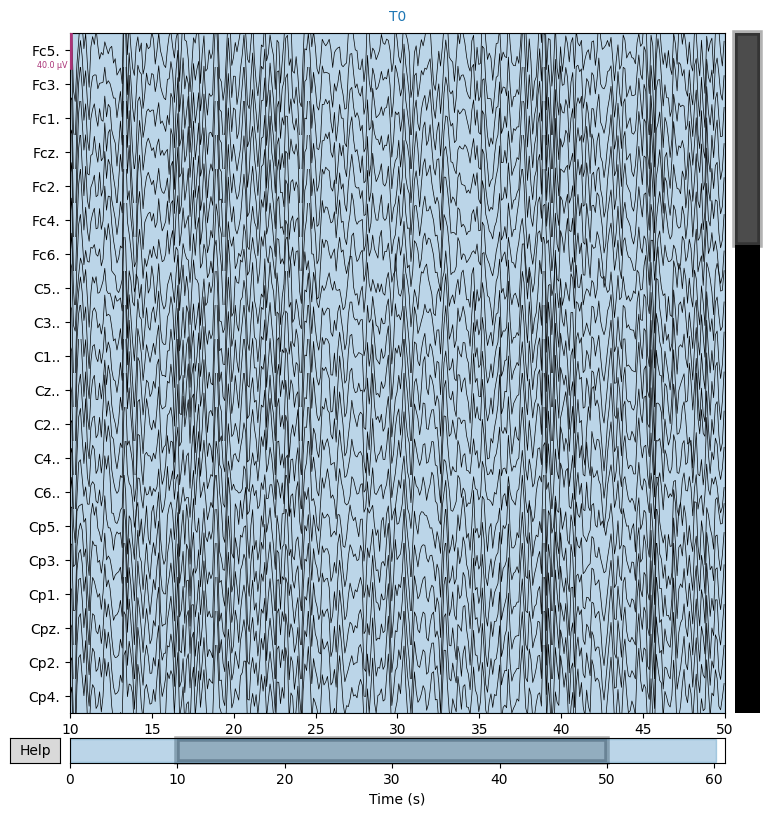

In [24]:
for i,j in enumerate(person_1_path_list):
    # i being the index and j being the file path
    # will need to make sure that i starts from 1 and not from 0
    # since only first two are 60 seconds long
    if(i==0)or (i==1):
        print(f'PERSON{i+1}')
        print(f'Task Performed: {task_description[i+1]}')
        plot_function(j,1,3,info_needed=True,start_time=10,duration=40)

For the first two persons there is only one sort of activity which is T0 i.e. person at rest

IS THERE ANY DATA AMONG THE 109 PERSONS IN WHICH ALL OF THE TEST HAVENT BEEN OBTAINED/DONE?

PERSON3
Task Performed: Task 1 (open and close left or right fist)
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 3 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 3.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 4.00 Hz)
- Filter length: 529 samples (3.306 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


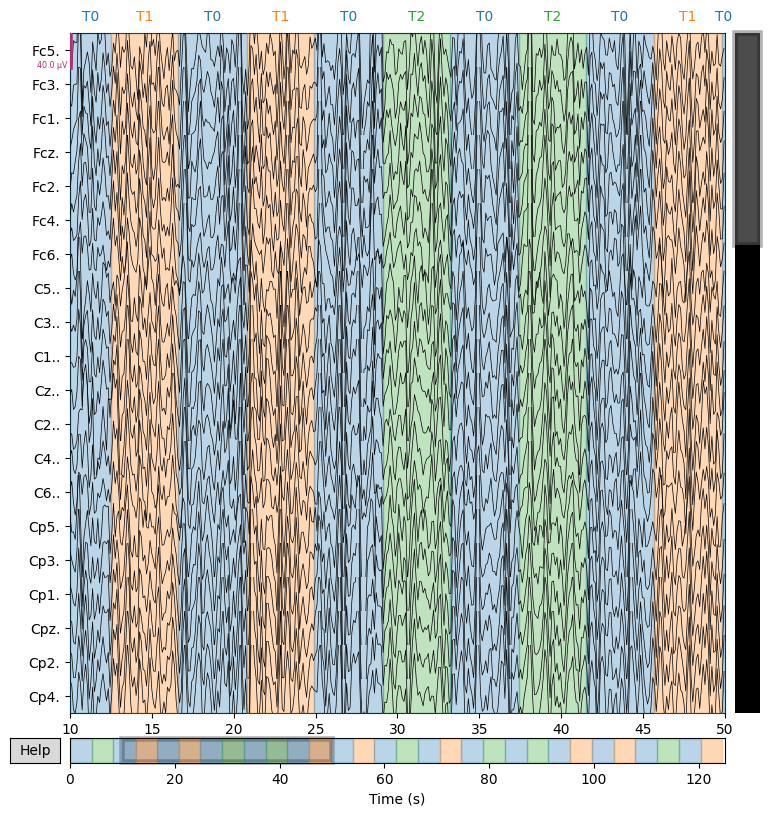

PERSON4
Task Performed: Task 2 (imagine opening and closing left or right fist)
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R04.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 3 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 3.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 4.00 Hz)
- Filter length: 529 samples (3.306 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


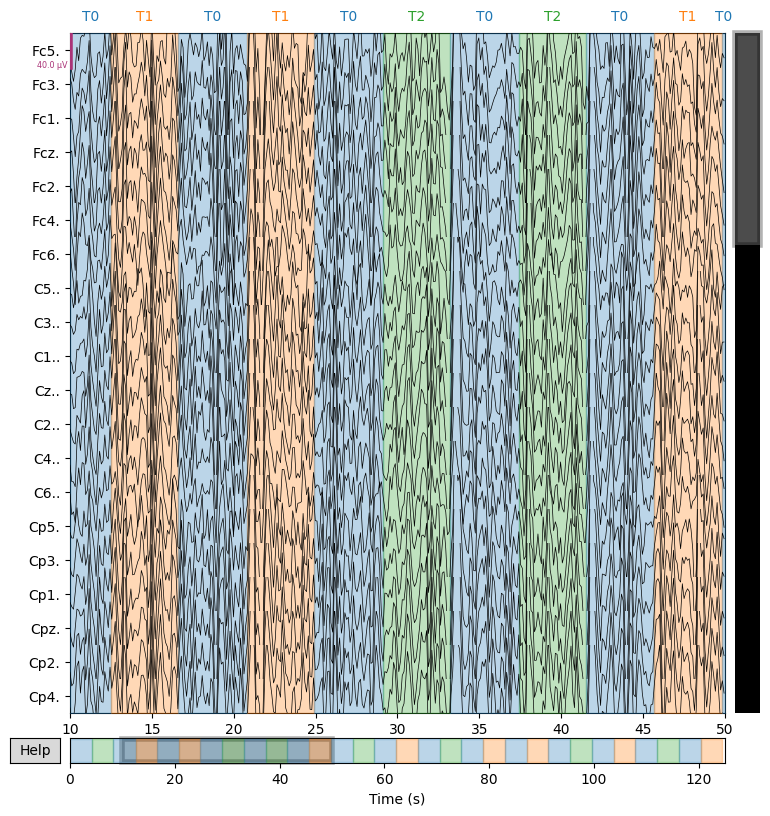

PERSON5
Task Performed: Task 3 (open and close both fists or both feet)
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R05.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 3 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 3.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 4.00 Hz)
- Filter length: 529 samples (3.306 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


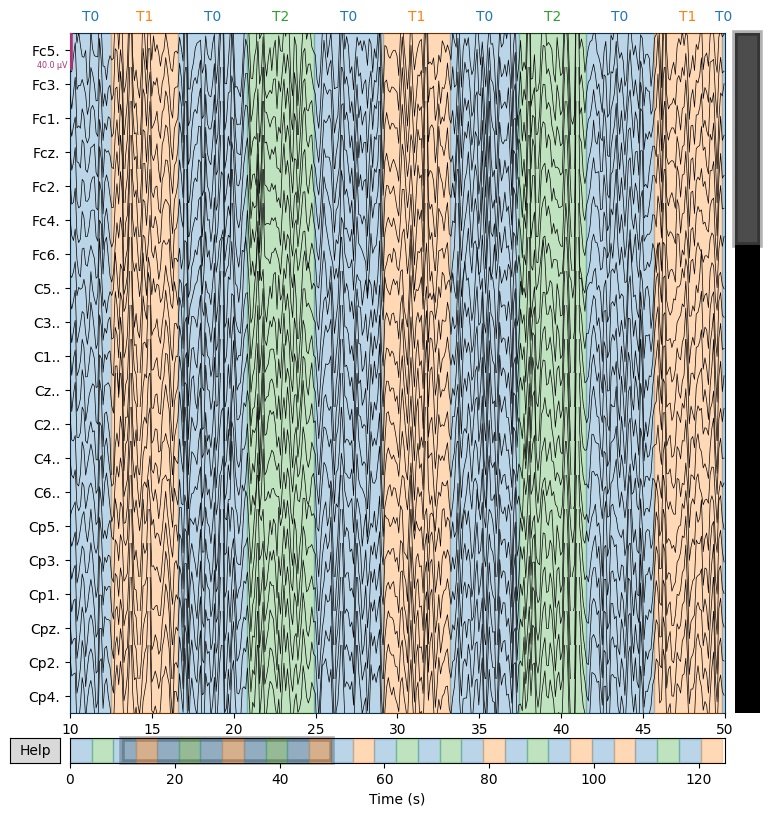

PERSON6
Task Performed: Task 4 (imagine opening and closing both fists or both feet)
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R06.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 3 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 3.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 4.00 Hz)
- Filter length: 529 samples (3.306 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


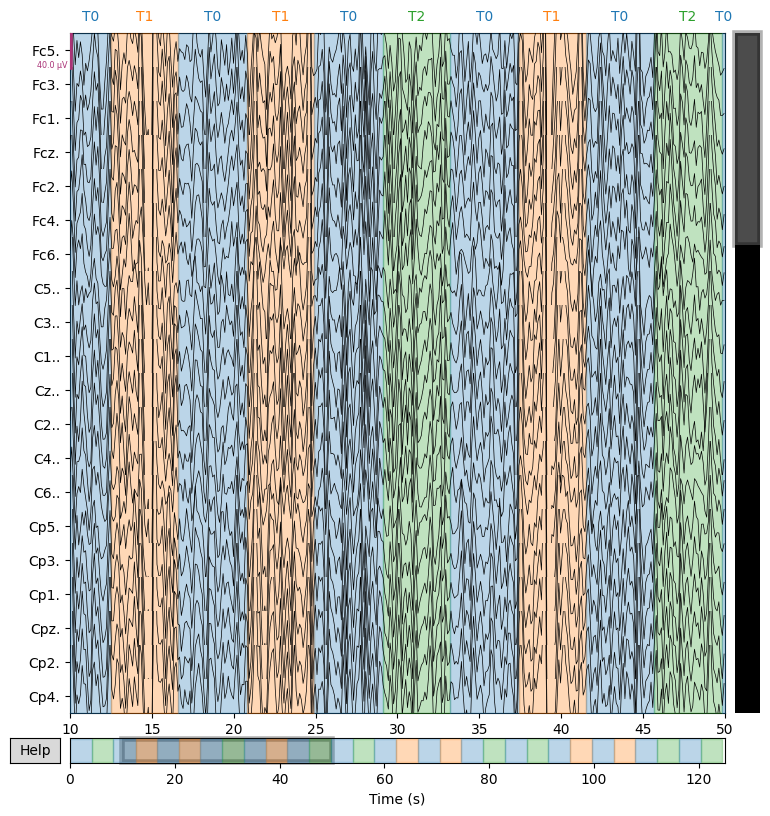

PERSON7
Task Performed: Task 1
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 3 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 3.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 4.00 Hz)
- Filter length: 529 samples (3.306 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


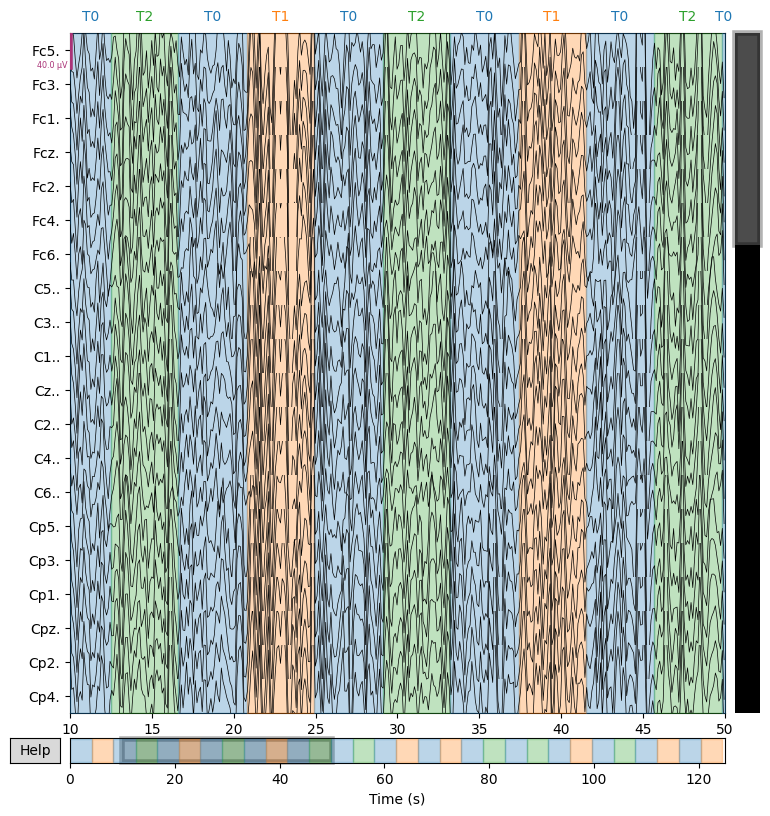

PERSON8
Task Performed: Task 2
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R08.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 3 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 3.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 4.00 Hz)
- Filter length: 529 samples (3.306 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


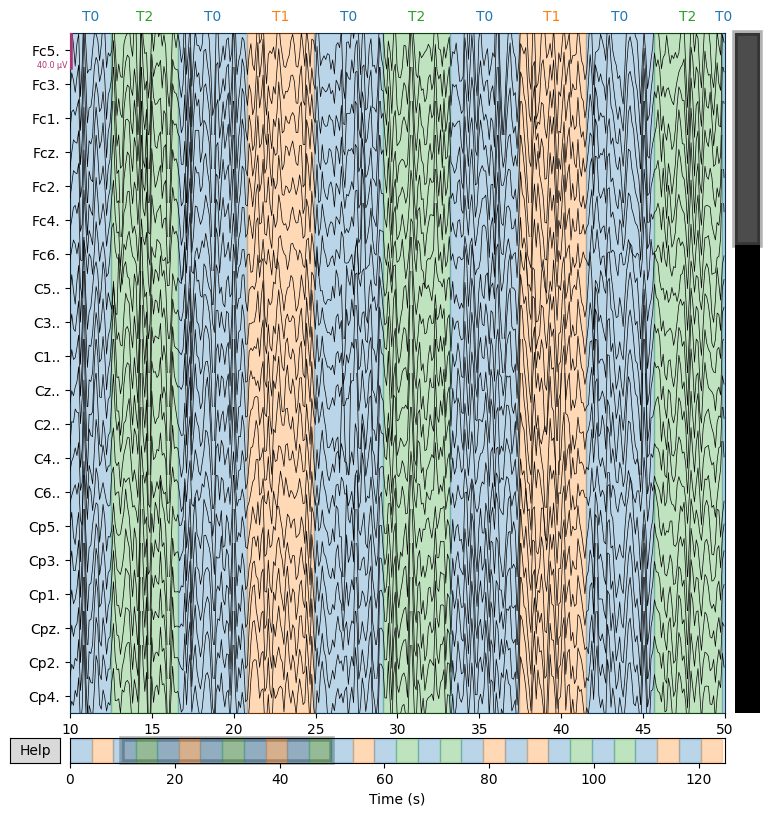

PERSON9
Task Performed: Task 3
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R09.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 3 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 3.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 4.00 Hz)
- Filter length: 529 samples (3.306 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


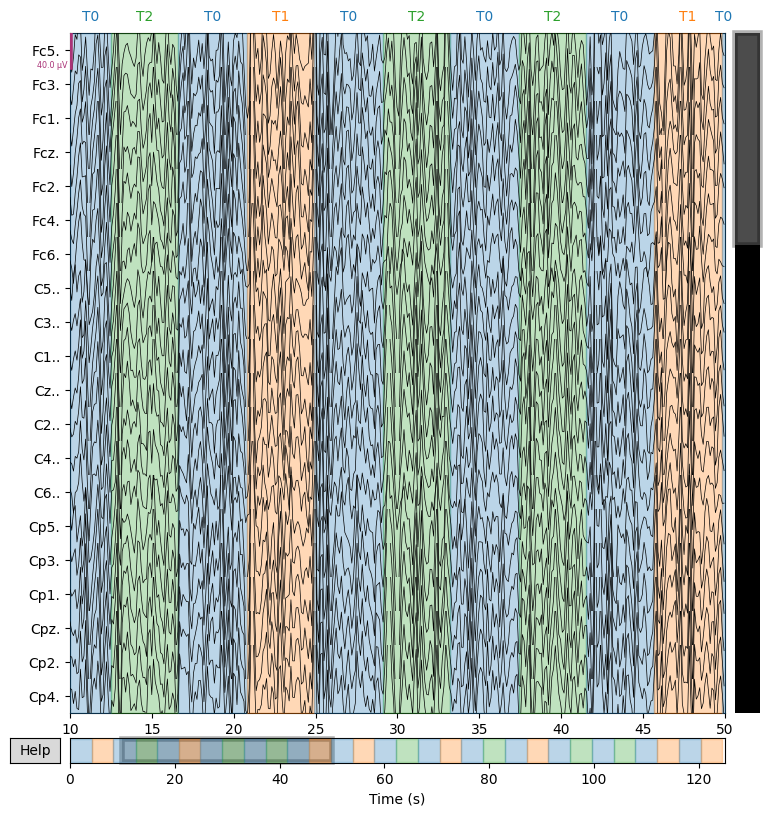

PERSON10
Task Performed: Task 4
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R10.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 3 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 3.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 4.00 Hz)
- Filter length: 529 samples (3.306 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


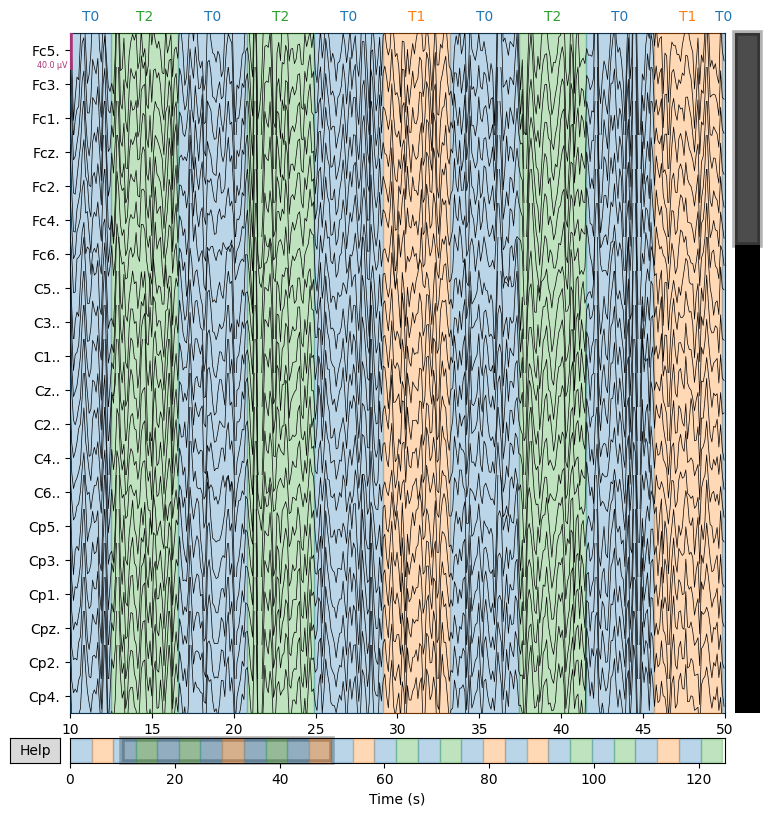

PERSON11
Task Performed: Task 1
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 3 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 3.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 4.00 Hz)
- Filter length: 529 samples (3.306 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


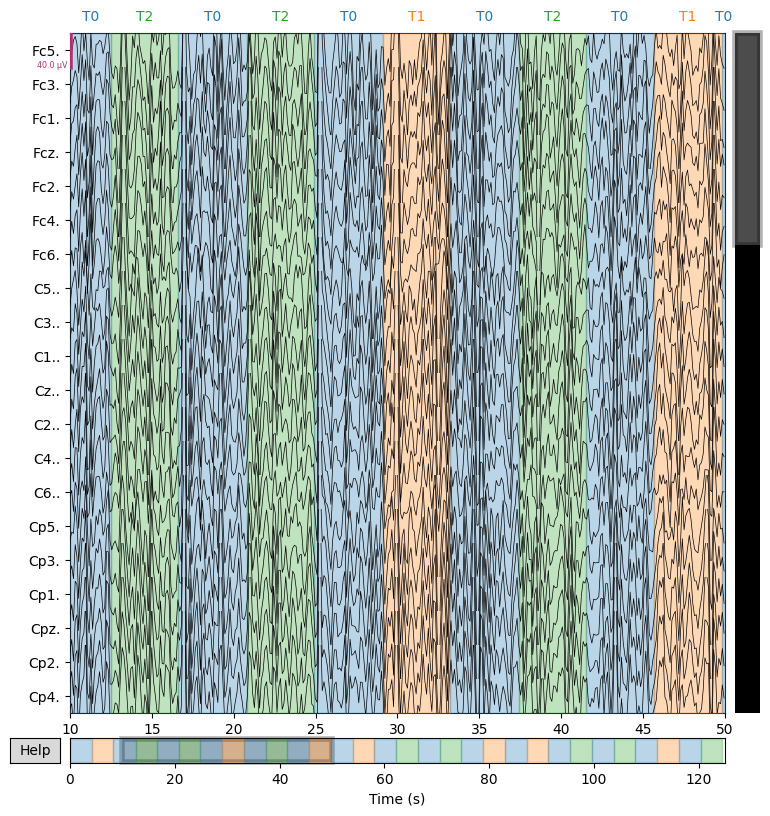

PERSON12
Task Performed: Task 2
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R12.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 3 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 3.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 4.00 Hz)
- Filter length: 529 samples (3.306 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


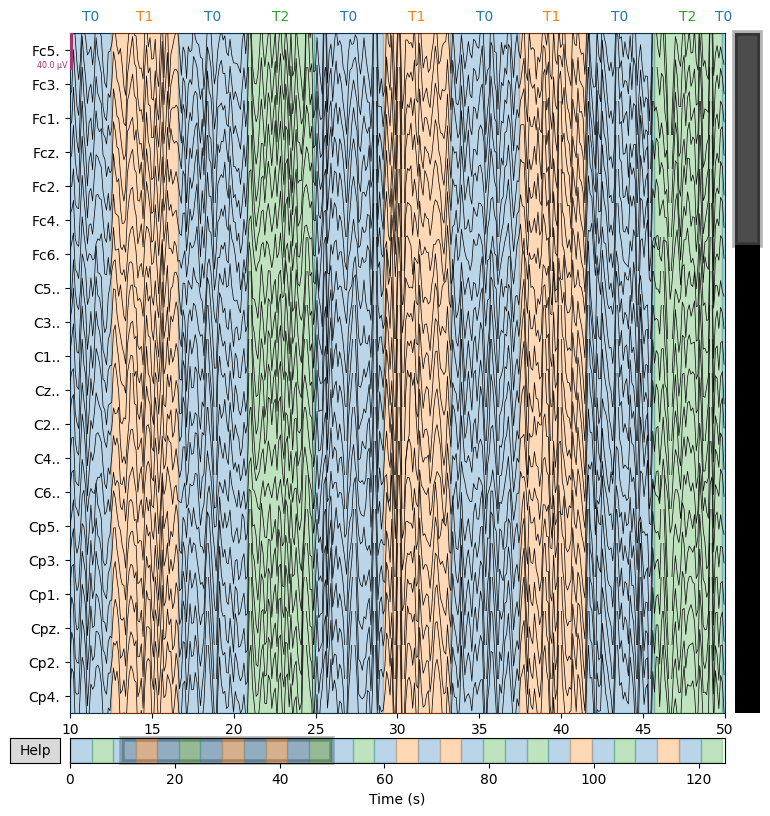

PERSON13
Task Performed: Task 3
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R13.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 3 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 3.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 4.00 Hz)
- Filter length: 529 samples (3.306 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


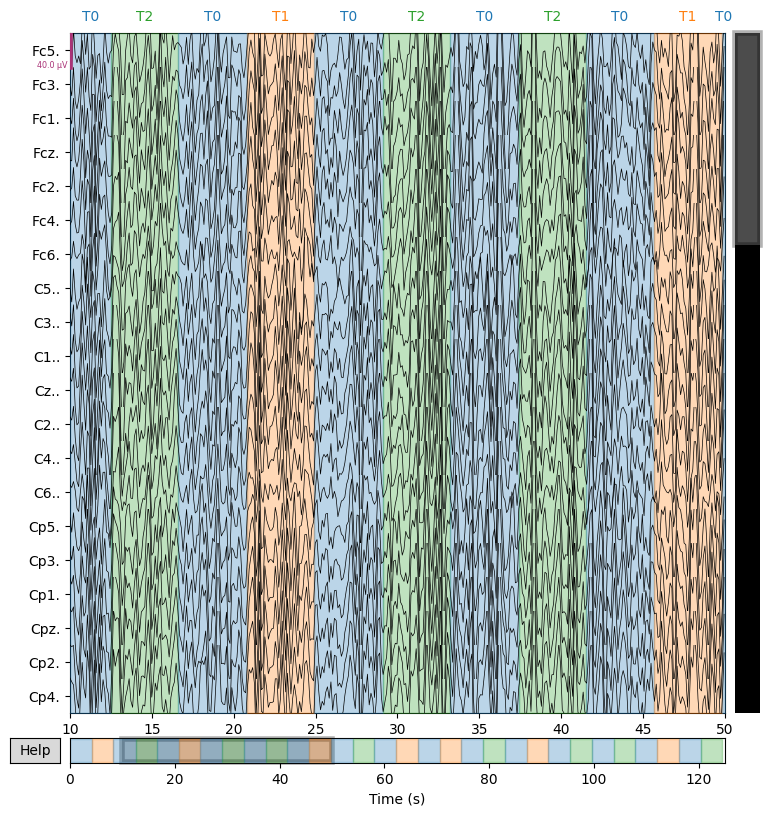

PERSON14
Task Performed: Task 4
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R14.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 3 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 3.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 4.00 Hz)
- Filter length: 529 samples (3.306 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


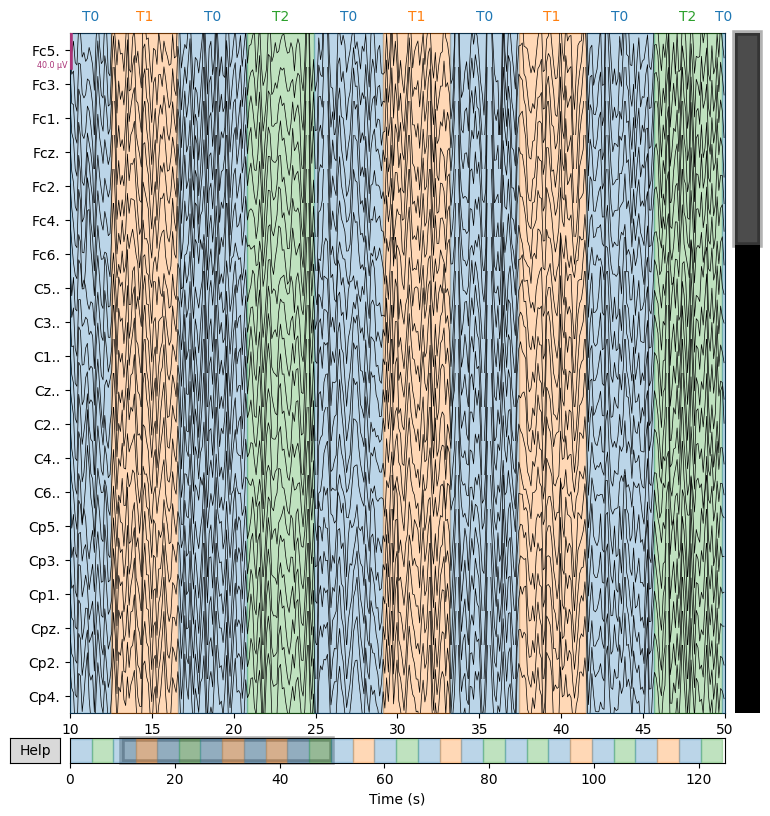

In [25]:
for i,j in enumerate(person_1_path_list):
    # i being the index and j being the file path
    # will need to make sure that i starts from 1 and not from 0
    # since only first two are 60 seconds long
    if i != 0 and i != 1:
        print(f'PERSON{i+1}')
        print(f'Task Performed: {task_description[i+1]}')
        plot_function(file_path=j, low_frequency=1,high_frequency=3, info_needed=True, start_time=10, duration=40)

In [26]:
import mne
list_of_duration=[]
def number_of_seconds_of_each_edf(file_path):
    raw = mne.io.read_raw_edf(file_path, preload=True)
    duration_seconds = raw.n_times / raw.info['sfreq']
    return duration_seconds

for file_path in person_1_path_list:
    duration = number_of_seconds_of_each_edf(file_path)
    print(f"The duration of the EEG data in {file_path} is approximately {duration:.2f} seconds.")
    list_of_duration.append(duration)


Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R01.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 9759  =      0.000 ...    60.994 secs...
The duration of the EEG data in EEG_data/S001\S001R01.edf is approximately 61.00 seconds.
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R02.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 9759  =      0.000 ...    60.994 secs...
The duration of the EEG data in EEG_data/S001\S001R02.edf is approximately 61.00 seconds.
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
The duration of the EEG data in EEG_data/S001\S001R03.edf is approximately 125.00 seconds.
Extracting EDF param

In [27]:
for i in list_of_duration:
    print(i)

61.0
61.0
125.0
125.0
125.0
125.0
125.0
125.0
125.0
125.0
125.0
125.0
125.0
125.0


This is the total amount of time for each EDF

In [28]:
import mne

raw = mne.io.read_raw_edf(person_1_path_list[0], preload=True)


sampling_frequency = raw.info['sfreq']


nyquist_frequency = sampling_frequency / 2

print(f"The sampling frequency is {sampling_frequency} Hz.")
print(f"The Nyquist frequency is {nyquist_frequency} Hz.")


Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R01.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 9759  =      0.000 ...    60.994 secs...
The sampling frequency is 160.0 Hz.
The Nyquist frequency is 80.0 Hz.


So maximum frequence of any of them is 80Hz

In [29]:
person_1_path_list[0]

'EEG_data/S001\\S001R01.edf'

CURRENTLY, I GOT TO KNOW ABOUT THE DATA T0 ,T1,T2 ETC

In [30]:
import os

def get_files_with_extension(directory, extension):
    file_paths = []
    for root, _, files in os.walk(directory):
        for file in files:
            if file.endswith(extension):
                file_paths.append(os.path.join(root, file))
    return file_paths

directory = "EEG_data"

edf_files = get_files_with_extension(directory, ".edf")

for file_path in edf_files:
    print(file_path)

folders_with_less_files = []
for folder in os.listdir(directory):
    folder_path = os.path.join(directory, folder)
    if os.path.isdir(folder_path):
        files_in_folder = len([name for name in os.listdir(folder_path) if name.endswith('.edf')])
        if files_in_folder < 14:
            folders_with_less_files.append(folder_path)

if folders_with_less_files:
    print("\nFolders with less than 14 .edf files:")
    for folder in folders_with_less_files:
        print(folder)
else:
    print("\nAll folders have 14 or more .edf files.")


EEG_data\S001\S001R01.edf
EEG_data\S001\S001R02.edf
EEG_data\S001\S001R03.edf
EEG_data\S001\S001R04.edf
EEG_data\S001\S001R05.edf
EEG_data\S001\S001R06.edf
EEG_data\S001\S001R07.edf
EEG_data\S001\S001R08.edf
EEG_data\S001\S001R09.edf
EEG_data\S001\S001R10.edf
EEG_data\S001\S001R11.edf
EEG_data\S001\S001R12.edf
EEG_data\S001\S001R13.edf
EEG_data\S001\S001R14.edf
EEG_data\S002\S002R01.edf
EEG_data\S002\S002R02.edf
EEG_data\S002\S002R03.edf
EEG_data\S002\S002R04.edf
EEG_data\S002\S002R05.edf
EEG_data\S002\S002R06.edf
EEG_data\S002\S002R07.edf
EEG_data\S002\S002R08.edf
EEG_data\S002\S002R09.edf
EEG_data\S002\S002R10.edf
EEG_data\S002\S002R11.edf
EEG_data\S002\S002R12.edf
EEG_data\S002\S002R13.edf
EEG_data\S002\S002R14.edf
EEG_data\S003\S003R01.edf
EEG_data\S003\S003R02.edf
EEG_data\S003\S003R03.edf
EEG_data\S003\S003R04.edf
EEG_data\S003\S003R05.edf
EEG_data\S003\S003R06.edf
EEG_data\S003\S003R07.edf
EEG_data\S003\S003R08.edf
EEG_data\S003\S003R09.edf
EEG_data\S003\S003R10.edf
EEG_data\S00

So there is no folder in which I have less number of edf files. all of them have the same

In [31]:
person_2_path_list=glob('EEG_data/S002/*.edf')

In [32]:
import mne

def compare_eeg_plots(*args, start=0, duration=None, low_freq=None, high_freq=None):
    for file_path in args:
        raw = mne.io.read_raw_edf(file_path, preload=True)
        
        if low_freq is not None and high_freq is not None:
            raw.filter(low_freq, high_freq)

        raw.plot(start=start, duration=duration)
    
    plt.show()

# Example usage:
# compare_eeg_plots('path_to_file1.edf', 'path_to_file2.edf', start=10, duration=20, low_freq=1, high_freq=30)


Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R01.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 9759  =      0.000 ...    60.994 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 5.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 6.00 Hz)
- Filter length: 265 samples (1.656 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


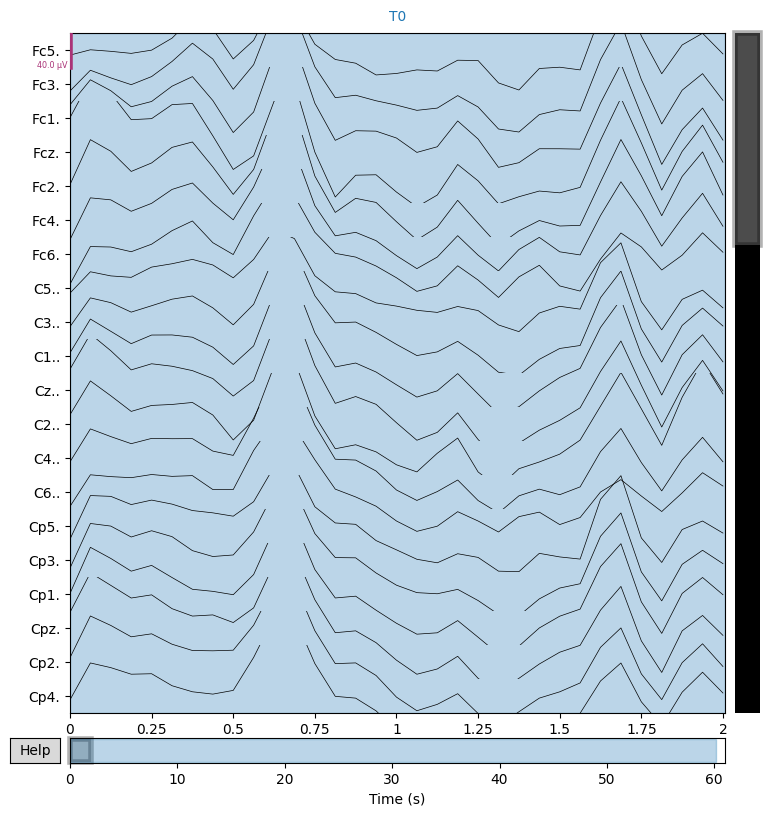

Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R02.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 9759  =      0.000 ...    60.994 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 5.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 6.00 Hz)
- Filter length: 265 samples (1.656 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


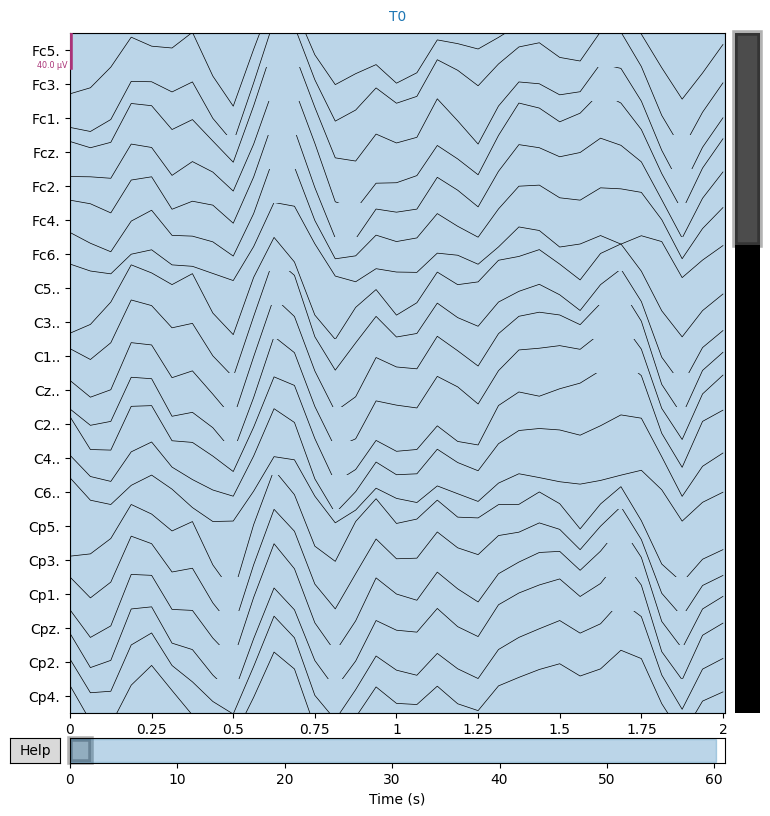

Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 5.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 6.00 Hz)
- Filter length: 265 samples (1.656 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


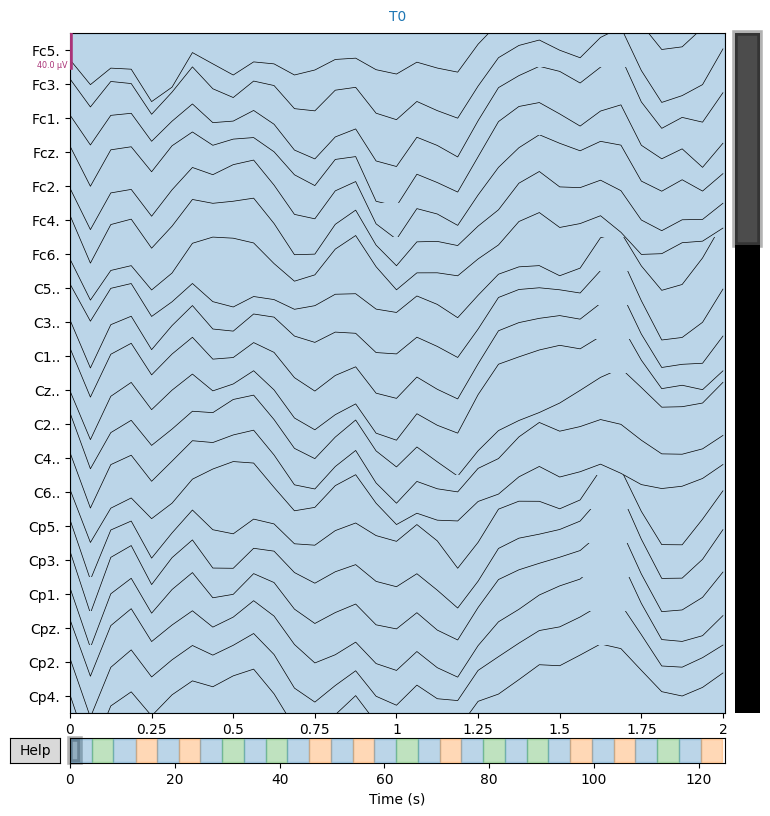

In [33]:
compare_eeg_plots(person_1_path_list[0],person_1_path_list[1],person_1_path_list[2],start=0,duration=2,low_freq=0,high_freq=5)

CONCLUSIONS TILL NOW;
FOR EACH PERSON (109) THERE WEREA TOTAL OF 14 TESTS AMONG WHICH FIRST TWO WERE RELATED TO SLEEP AND REST WERE SOME TASKS


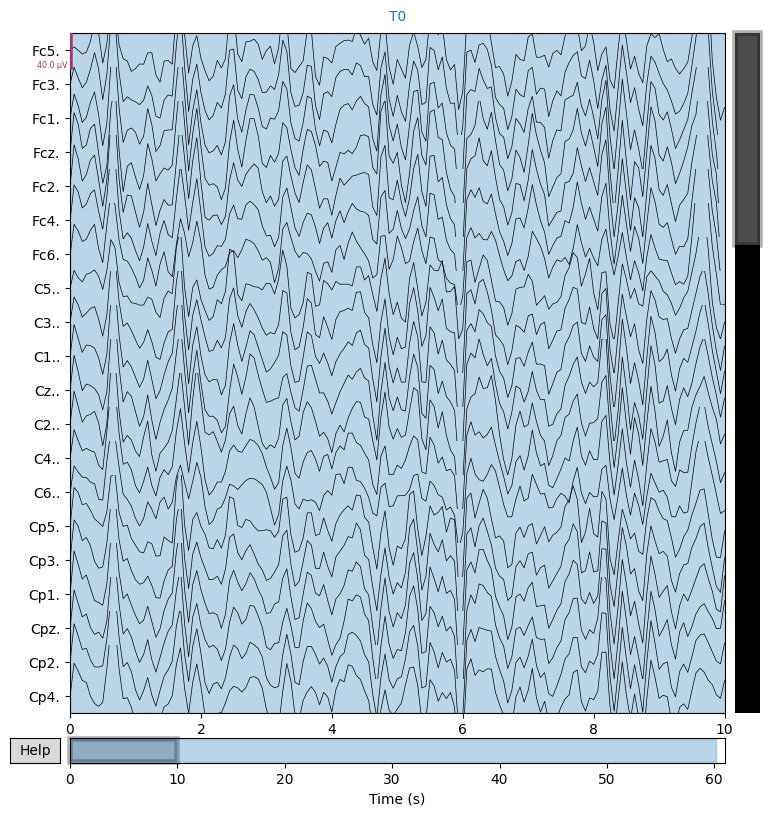

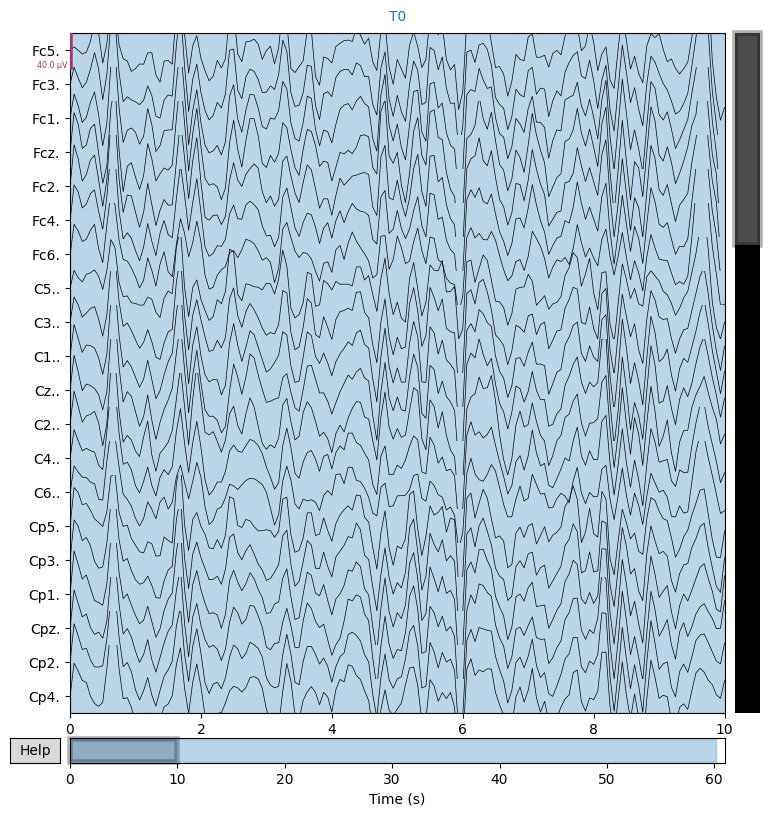

In [92]:
raw.plot()

<H3>EPOCH DIVIDING</H3>

In [68]:
raw = mne.io.read_raw_edf(person_1_path_list[0], preload=True)
annotations = mne.read_annotations('person_1_annotatio.txt')

Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R01.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 9759  =      0.000 ...    60.994 secs...


FileNotFoundError: fname does not exist: "d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\person_1_annotatio.txt"

Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R05.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...


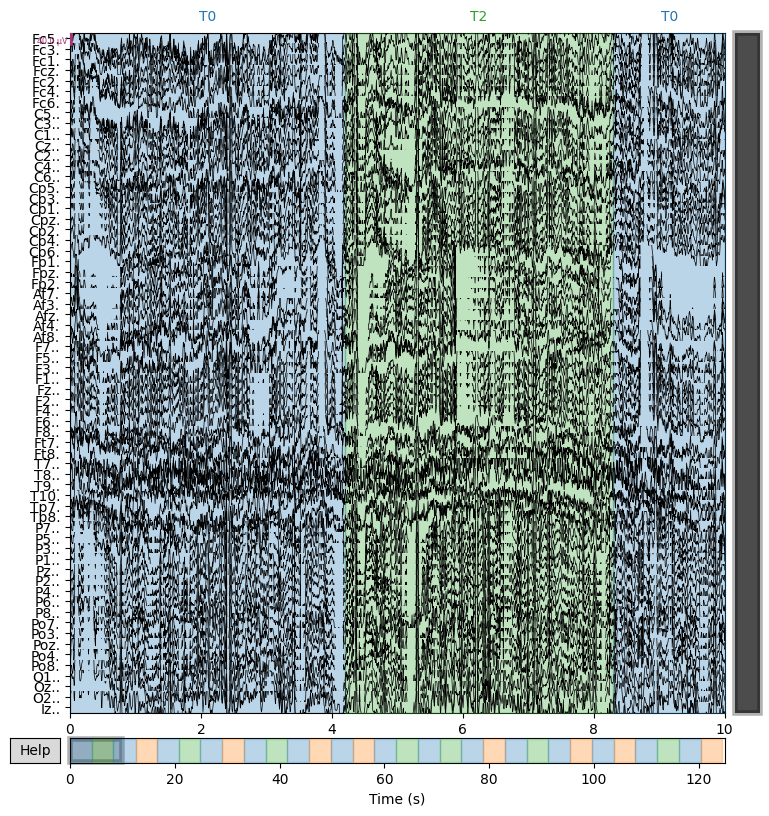

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_22364\2690246584.py:4: FutureWarning: The default for pick_channels will change from ordered=False to ordered=True in 1.5 and this will result in an error because the following channel names are missing:
['Fc5']
Either fix your included names or explicitly pass ordered=False.
  events = mne.find_events(raw, stim_channel=event_channel)


ValueError: No stim channel found to extract event triggers.

In [34]:

raw = mne.io.read_raw_edf(person_1_path_list[4], preload=True)
raw.plot(n_channels=64)
event_channel = 'Fc5'  
events = mne.find_events(raw, stim_channel=event_channel)



In [71]:
import mne

raw = mne.io.read_raw_edf(person_1_path_list[0], preload=True)

event_id = {'T0': 0, 'T1': 1, 'T2': 2}

# Extract events from the TargetCode state variable
events = mne.find_events(raw, stim_channel='TargetCode', output='onset', event_id=event_id)

Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R01.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 9759  =      0.000 ...    60.994 secs...


TypeError: find_events() got an unexpected keyword argument 'event_id'

Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R01.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 9759  =      0.000 ...    60.994 secs...
Used Annotations descriptions: ['T0']
Not setting metadata
1 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 1 events and 1601 original time points ...
1 bad epochs dropped


C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_22364\1058062413.py:14: RuntimeWarning: All epochs were dropped!
You might need to alter reject/flat-criteria or drop bad channels to avoid this. You can use Epochs.plot_drop_log() to see which channels are responsible for the dropping of epochs.
  epochs.drop_bad()


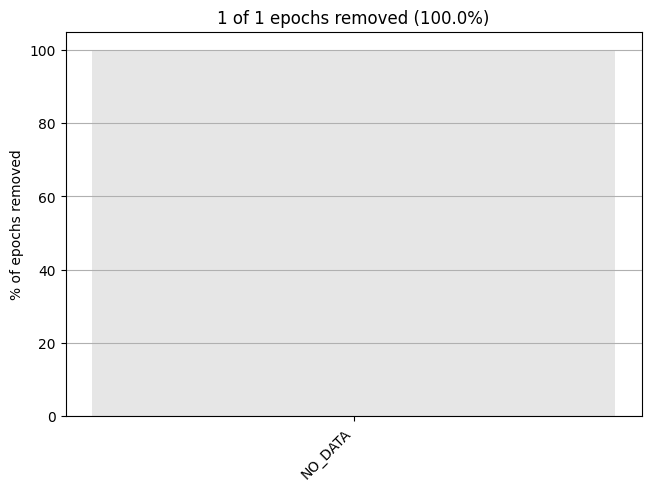

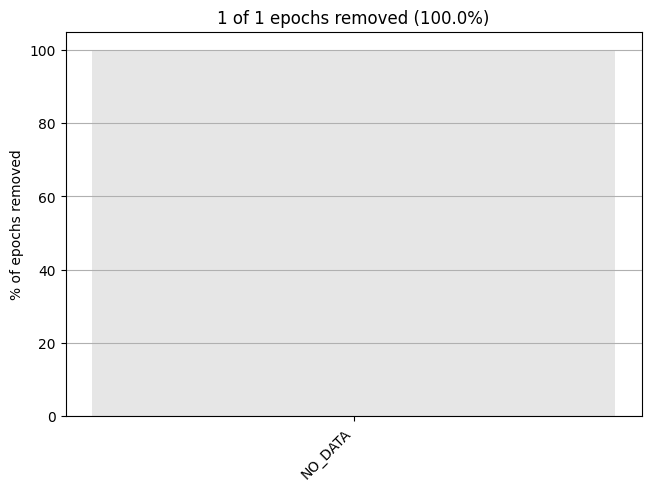

In [42]:
import mne

# Load the EEG data
raw = mne.io.read_raw_edf(person_1_path_list[0], preload=True)

# Extract events from annotations
events, event_dict = mne.events_from_annotations(raw)

# Define event IDs
event_id = {'T0': 1}

# Create epochs based on events
epochs = mne.Epochs(raw, events, event_id=event_id, tmin=-5, tmax=5, baseline=None)
epochs.drop_bad()
epochs.plot_drop_log()
# Separate each event
# event_T0 = epochs['T0']

# Save or process each event separately
# event_T0.save('event_T0-epo.fif')


In [43]:
import mne

raw = mne.io.read_raw_edf(person_1_path_list[4], preload=True)

event_id = {'T0': 0, '1': 1, 't2': 2}

events, _ = mne.events_from_annotations(raw, event_id=event_id)


epochs = mne.Epochs(raw, events, event_id=event_id, tmin=-5, tmax=5, baseline=None)

event_t0 = epochs['t0']
event_t1 = epochs['t1']
event_t2 = epochs['t2']

# Save or process each event separately
event_t0.save('event_t0-epo.fif')
event_t1.save('event_t1-epo.fif')
event_t2.save('event_t2-epo.fif')


Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R05.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...


ValueError: Could not find any of the events you specified.

Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R01.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 9759  =      0.000 ...    60.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 529 samples (3.306 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


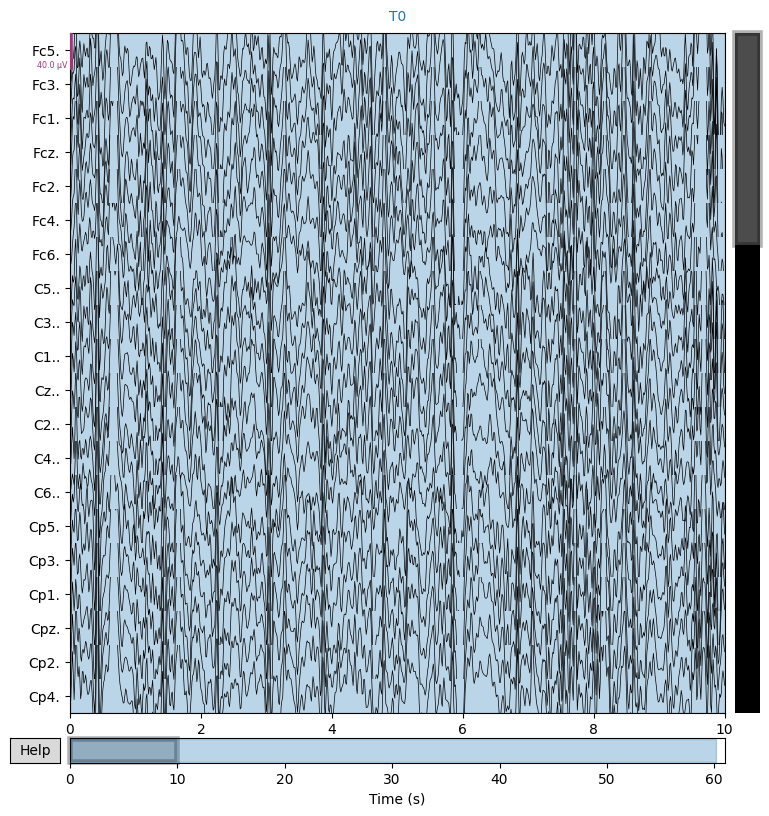

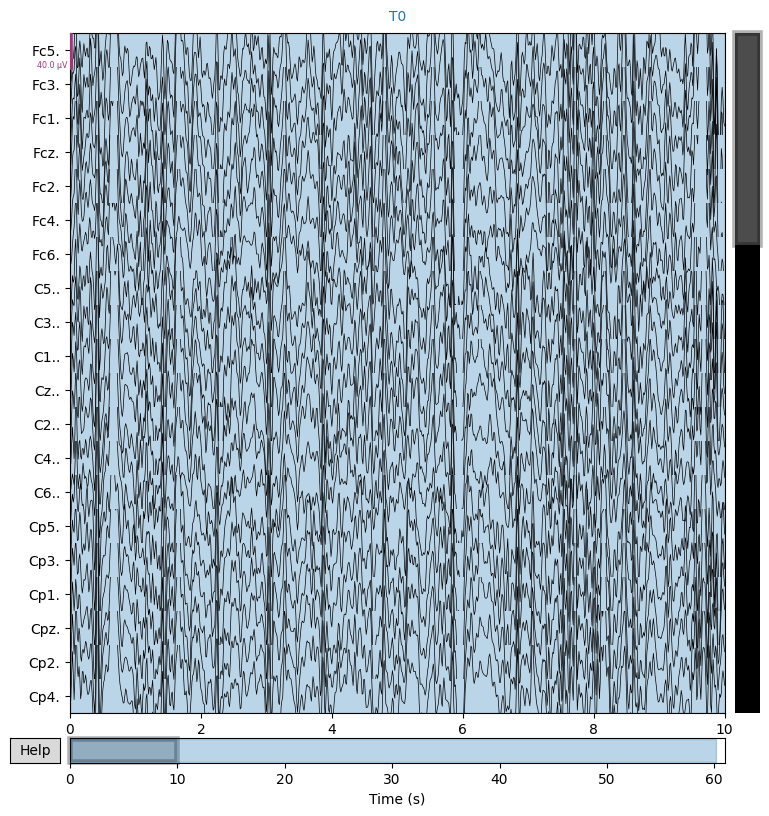

In [35]:
raw=mne.io.read_raw_edf(person_1_path_list[0],preload=True)
raw.filter(1,20)
raw.plot()

In [36]:
ica=mne.preprocessing.ICA(n_components=20,random_state=0)

In [37]:
ica.fit(raw.copy().filter(8,35))

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 8 - 35 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 8.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 7.00 Hz)
- Upper passband edge: 35.00 Hz
- Upper transition bandwidth: 8.75 Hz (-6 dB cutoff frequency: 39.38 Hz)
- Filter length: 265 samples (1.656 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 3.5s.


Method,fastica
Fit parameters,algorithm=parallelfun=logcoshfun_args=Nonemax_iter=1000
Fit,52 iterations on raw data (9760 samples)
ICA components,20
Available PCA components,64
Channel types,eeg
ICA components marked for exclusion,—


In [39]:
ica.plot_components(outlines="skirt")

RuntimeError: No digitization points found.

In [48]:
ica = mne.preprocessing.ICA(n_components=20, random_state=97, max_iter=800)
ica.fit(raw)
ica.exclude = [0, 1]  # Example: Exclude first two components
raw_corrected = raw.copy().apply_ica(ica)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_22364\1840496668.py:2: RuntimeWarning: The data has not been high-pass filtered. For good ICA performance, it should be high-pass filtered (e.g., with a 1.0 Hz lower bound) before fitting ICA.
  ica.fit(raw)


Selecting by number: 20 components
Fitting ICA took 2.4s.


AttributeError: 'RawEDF' object has no attribute 'apply_ica'

In [53]:
raw.filter(None,30)

Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 71 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Measurement date,"August 12, 2009 16:15:00 GMT"
Experimenter,Unknown
Participant,X
Digitized points,Not available
Good channels,64 EEG
Bad channels,None
EOG channels,Not available
ECG channels,Not available
Sampling frequency,160.00 Hz
Highpass,0.00 Hz
Lowpass,30.00 Hz


NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 12.800 (s)


C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_22364\2847632005.py:1: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  raw.plot_psd()
c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


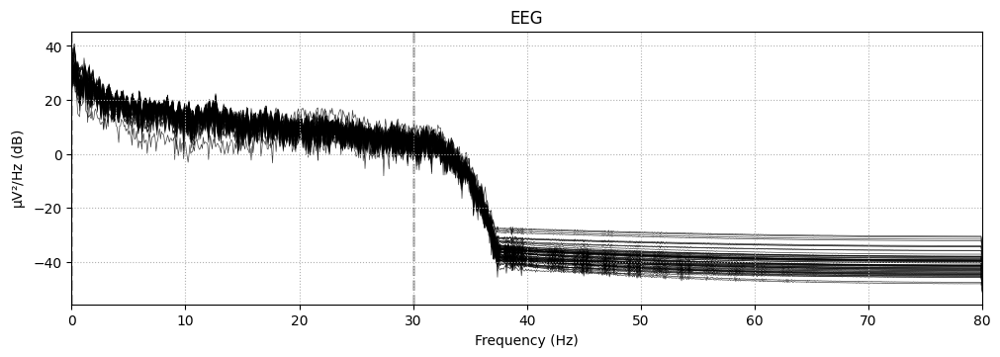

In [54]:
raw.plot_psd()

In [27]:
def extract_epochs(raw,chunk_duration=30.):
    description={
        'T1':1,
        # 'T1':1,
        # 'T2':2
    }
    events,_=mne.events_from_annotations(raw,event_id=description,chunk_duration=chunk_duration)
    tmax = 30. - 1. / raw.info['sfreq']  # tmax in included
    picks = mne.pick_types(raw.info, eeg=True, eog=True)
    epochs = mne.Epochs(raw=raw, events=events, picks=picks, preload=True,
                        event_id=event_id, tmin=0., tmax=tmax, baseline=None)
    
    return epochs.get_data(), epochs.events[:, 2] - 1

In [68]:
raw=mne.io.read_raw_edf(person_1_path_list[4],preload=True)
raw.filter(None,30)

Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R05.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 71 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Measurement date,"August 12, 2009 16:15:00 GMT"
Experimenter,Unknown
Participant,X
Digitized points,Not available
Good channels,64 EEG
Bad channels,None
EOG channels,Not available
ECG channels,Not available
Sampling frequency,160.00 Hz
Highpass,0.00 Hz
Lowpass,30.00 Hz


In [73]:
N_SUBJECT=109
BASELINE_EYE_OPEN=[1]
BASELINE_EYE_CLOSED=[2]
OPEN_CLOSE_LEFT_RIGHT_FIST=[3,7,11]
IMAGINE_OPEN_CLOSE_LEFT_RIGHT_FIST = [4, 8, 12]
OPEN_CLOSE_BOTH_FIST = [5, 9, 13]
IMAGINE_OPEN_CLOSE_BOTH_FIST = [6, 10, 14]

In [28]:
events, _ = mne.events_from_annotations(raw)

Used Annotations descriptions: ['T0']


In [30]:
# which eeg channel to pick
eeg_channel_inds = mne.pick_types(
    raw.info,
    meg=False,
    eeg=True,
    stim=False,
    eog=False,
    exclude='bads',
)
# epochs from data
epoched = mne.Epochs(
    raw,
    events,
    dict(base=1),
    tmin=1,
    tmax=4.1,
    proj=False,
    picks=eeg_channel_inds,
    baseline=None,
    preload=True
)

Not setting metadata
1 matching events found
No baseline correction applied
Using data from preloaded Raw for 1 events and 497 original time points ...
0 bad epochs dropped


In [93]:
raw=mne.io.read_raw_edf(person_1_path_list[2],preload=True)
raw.filter(None,30)
events, _ = mne.events_from_annotations(raw)

# which eeg channel to pick
eeg_channel_inds = mne.pick_types(
    raw.info,
    meg=False,
    eeg=True,
    stim=False,
    eog=False,
    exclude='bads',
)
# epochs from data
epoched = mne.Epochs(
    raw,
    events,
    dict(rest=1,left=2, right=3),
    tmin=1,
    tmax=60.1,
    proj=False,
    picks=eeg_channel_inds,
    baseline=None,
    preload=True
)

Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 71 samples (0.444 s)

Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
Using data from preloaded Raw for 30 events and 9457 original time points ...


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


14 bad epochs dropped


In [94]:
epoched

Number of events,16
Events,left: 4rest: 8right: 4
Time range,1.000 – 60.100 s
Baseline,off


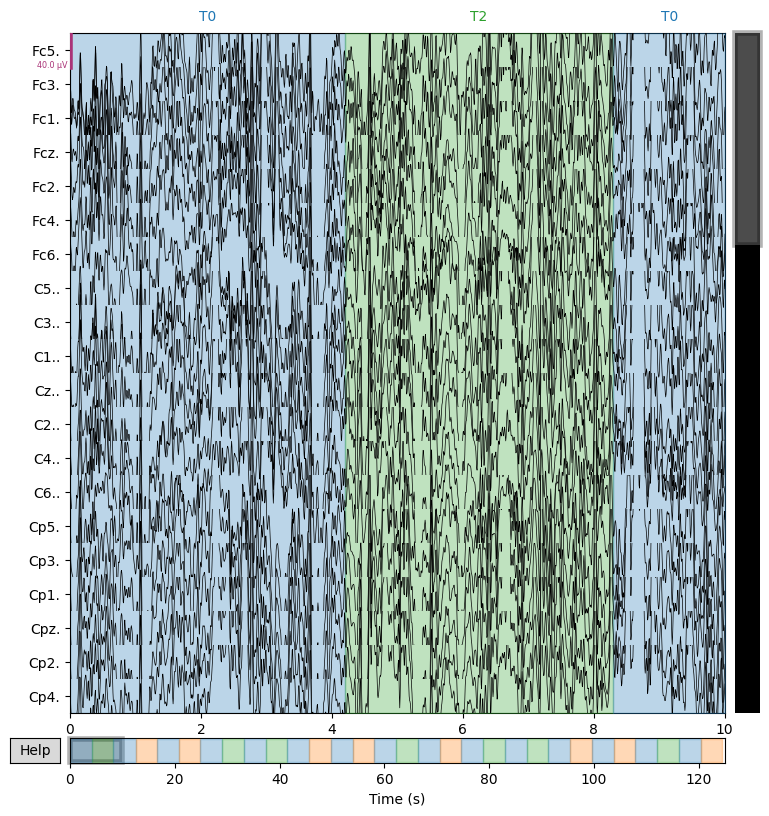

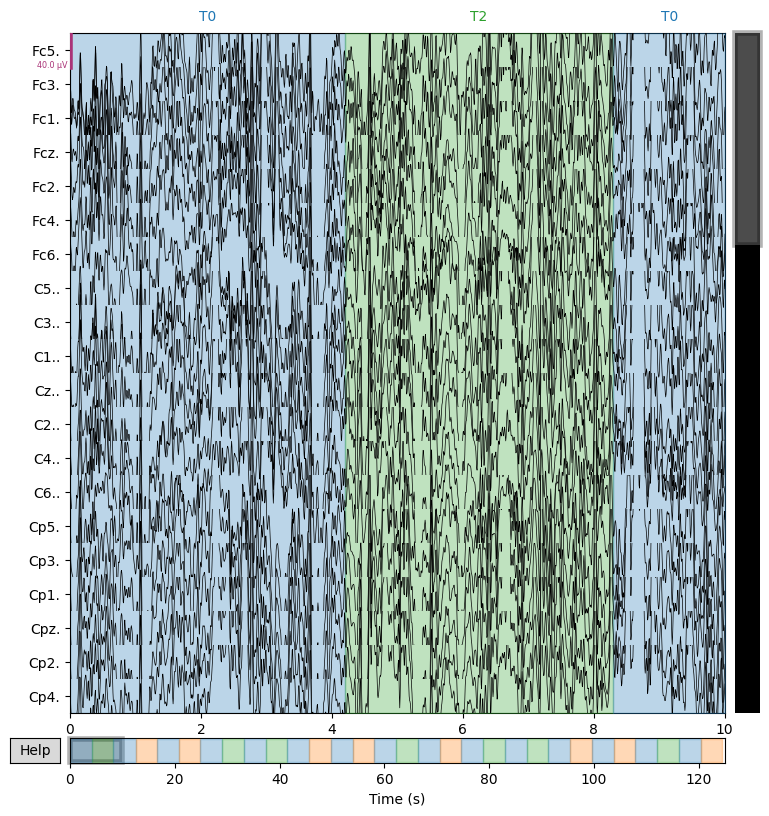

In [95]:
raw.plot()


In [96]:
aw=mne.io.read_raw_edf(person_1_path_list[2],preload=True)
raw.filter(l_freq=0.5, h_freq=30)  # Example cutoff frequencies, adjust as needed

# Notch filter to remove power line interference
raw.notch_filter(freqs=[50, 60])  

Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Measurement date,"August 12, 2009 16:15:00 GMT"
Experimenter,Unknown
Participant,X
Digitized points,Not available
Good channels,64 EEG
Bad channels,None
EOG channels,Not available
ECG channels,Not available
Sampling frequency,160.00 Hz
Highpass,0.50 Hz
Lowpass,30.00 Hz


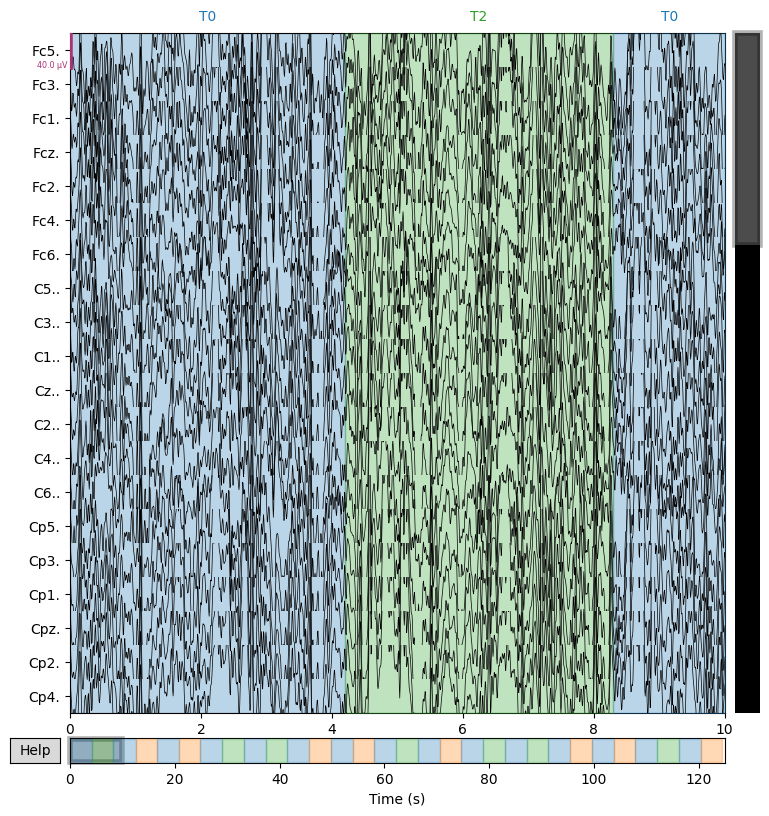

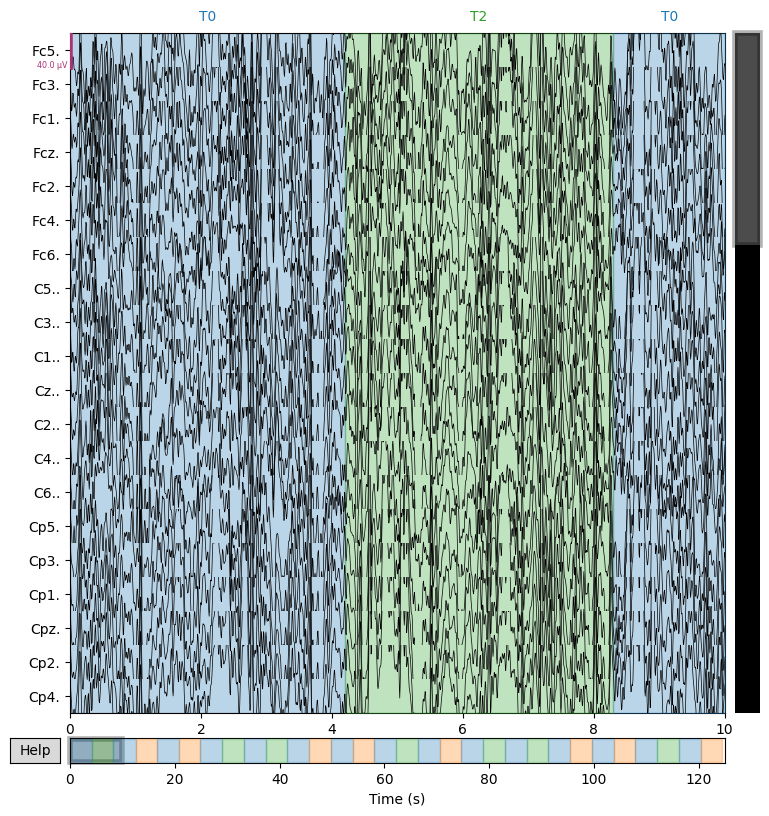

In [97]:
raw.plot()

In [101]:
from mne.preprocessing import ICA

# Create ICA object
ica = ICA(n_components=64, random_state=42)  # Assuming 64 EEG channels

# Fit ICA
ica.fit(raw)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


Selecting by number: 64 components
Fitting ICA took 3.6s.


Method,fastica
Fit parameters,algorithm=parallelfun=logcoshfun_args=Nonemax_iter=1000
Fit,73 iterations on raw data (20000 samples)
ICA components,64
Available PCA components,64
Channel types,eeg
ICA components marked for exclusion,—


In [99]:
print(raw.info)


<Info | 8 non-empty values
 bads: []
 ch_names: Fc5., Fc3., Fc1., Fcz., Fc2., Fc4., Fc6., C5.., C3.., C1.., ...
 chs: 64 EEG
 custom_ref_applied: False
 highpass: 0.5 Hz
 lowpass: 30.0 Hz
 meas_date: 2009-08-12 16:15:00 UTC
 nchan: 64
 projs: []
 sfreq: 160.0 Hz
 subject_info: 3 items (dict)
>


In [102]:
ica.plot_components()

RuntimeError: No digitization points found.

In [103]:
from mne.channels.montage import get_builtin_montages

montage_names = get_builtin_montages()
print(montage_names)


['standard_1005', 'standard_1020', 'standard_alphabetic', 'standard_postfixed', 'standard_prefixed', 'standard_primed', 'biosemi16', 'biosemi32', 'biosemi64', 'biosemi128', 'biosemi160', 'biosemi256', 'easycap-M1', 'easycap-M10', 'easycap-M43', 'EGI_256', 'GSN-HydroCel-32', 'GSN-HydroCel-64_1.0', 'GSN-HydroCel-65_1.0', 'GSN-HydroCel-128', 'GSN-HydroCel-129', 'GSN-HydroCel-256', 'GSN-HydroCel-257', 'mgh60', 'mgh70', 'artinis-octamon', 'artinis-brite23', 'brainproducts-RNP-BA-128']


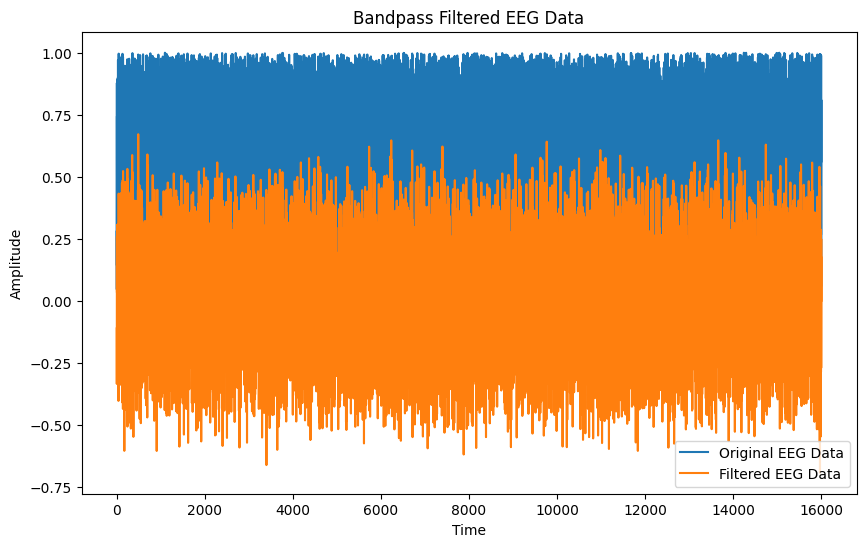

In [104]:
import numpy as np
from scipy.signal import butter, filtfilt
import matplotlib.pyplot as plt

# Sample EEG data (replace with your actual data)
eeg_data = np.random.rand(16000)  # Example: 160 seconds of data at 160 Hz

def butter_bandpass(lowcut, highcut, fs, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    return b, a

def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    filtered_data = filtfilt(b, a, data)
    return filtered_data

# EEG data parameters
fs = 160  # Sampling frequency
lowcut = 0.5  # Lower cutoff frequency
highcut = 50  # Upper cutoff frequency
order = 4  # Filter order

# Apply bandpass filter
filtered_data = butter_bandpass_filter(eeg_data, lowcut, highcut, fs, order=order)

# Plot original and filtered EEG data
plt.figure(figsize=(10, 6))
plt.plot(eeg_data, label='Original EEG Data')
plt.plot(filtered_data, label='Filtered EEG Data')
plt.xlabel('Time')
plt.ylabel('Amplitude')
plt.title('Bandpass Filtered EEG Data')
plt.legend()
plt.show()


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.4s


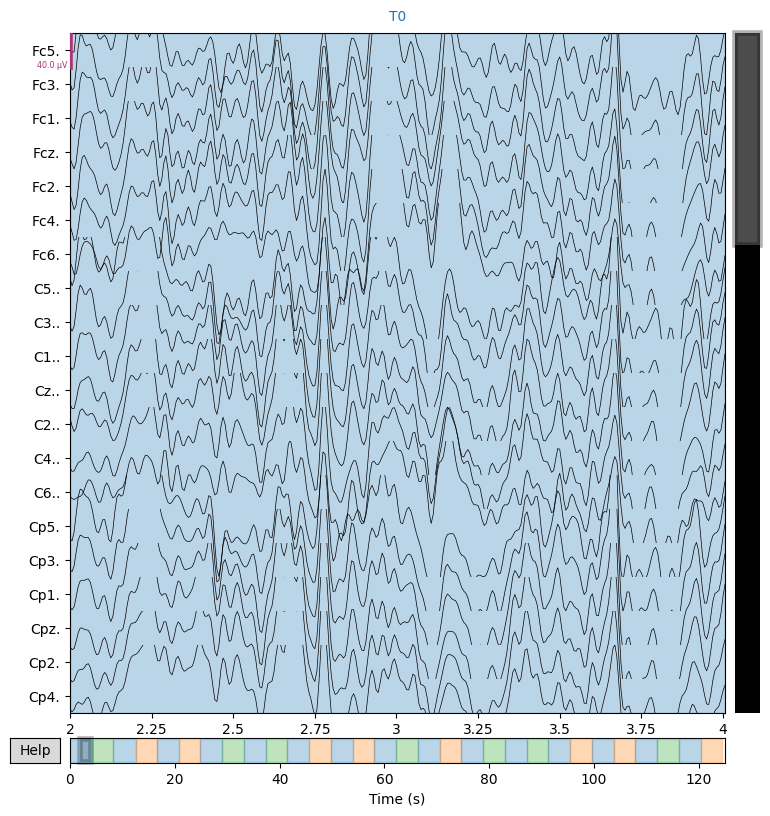

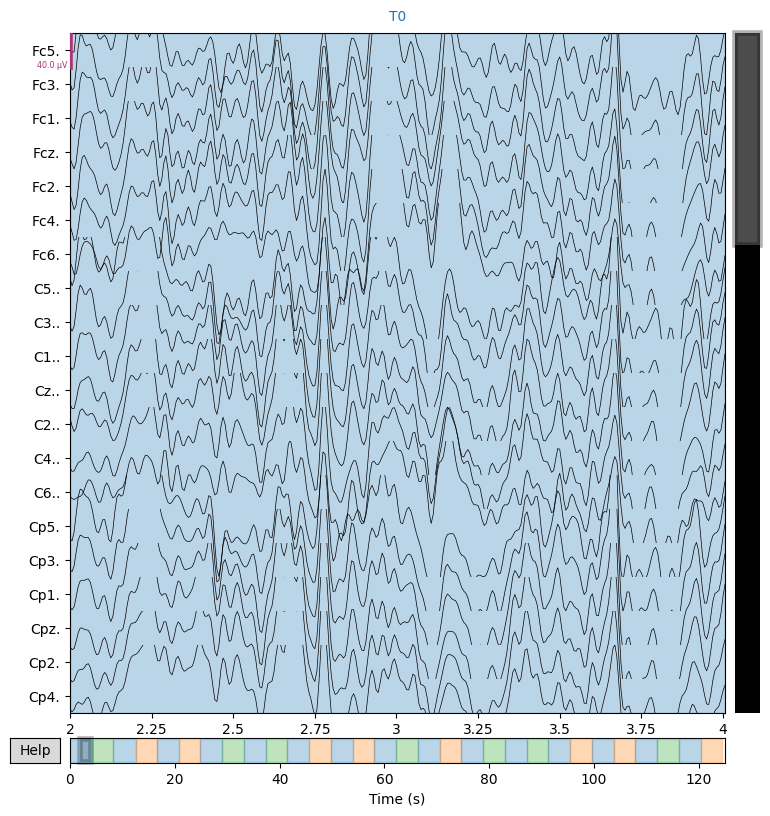

In [105]:
raw.filter(0.5,30)
raw.plot(start=2,duration=2)

In [49]:
raw=mne.io.read_raw_edf(person_1_path_list[2],preload=True)
from mne.preprocessing import ICA
raw.filter(0.5,30)
# Create ICA object
ica = ICA(n_components=20, random_state=42)  # Assuming 64 EEG channels

# Fit ICA
ica.fit(raw)


Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R02.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 9759  =      0.000 ...    60.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)
Selecting by number: 20 components


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.3s.


Method,fastica
Fit parameters,algorithm=parallelfun=logcoshfun_args=Nonemax_iter=1000
Fit,40 iterations on raw data (9760 samples)
ICA components,20
Available PCA components,64
Channel types,eeg
ICA components marked for exclusion,—


In [19]:
ica.apply(raw)

Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components


Measurement date,"August 12, 2009 16:15:00 GMT"
Experimenter,Unknown
Participant,X
Digitized points,Not available
Good channels,64 EEG
Bad channels,None
EOG channels,Not available
ECG channels,Not available
Sampling frequency,160.00 Hz
Highpass,0.50 Hz
Lowpass,30.00 Hz


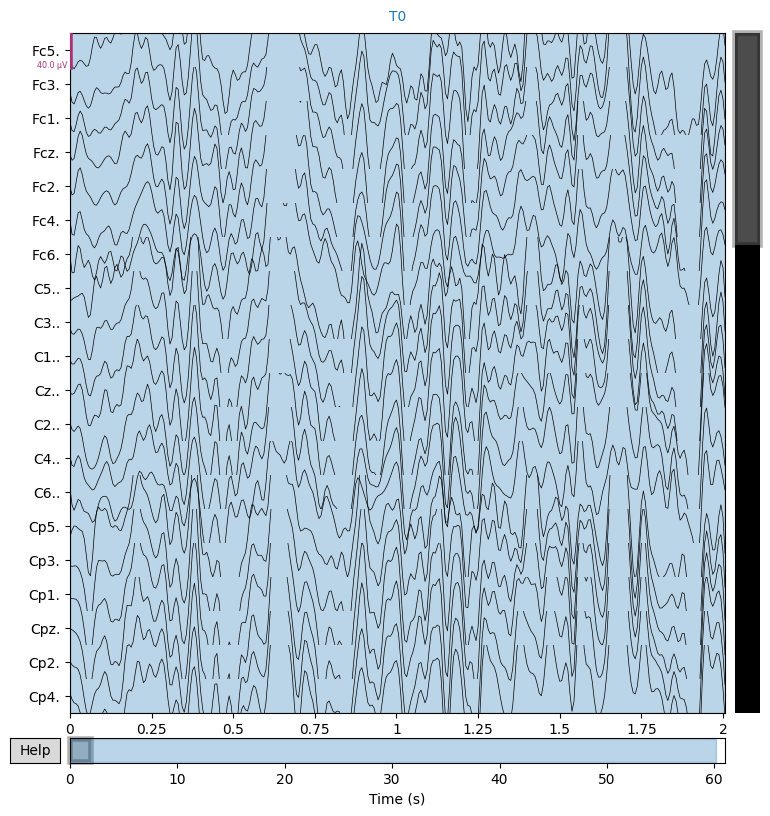

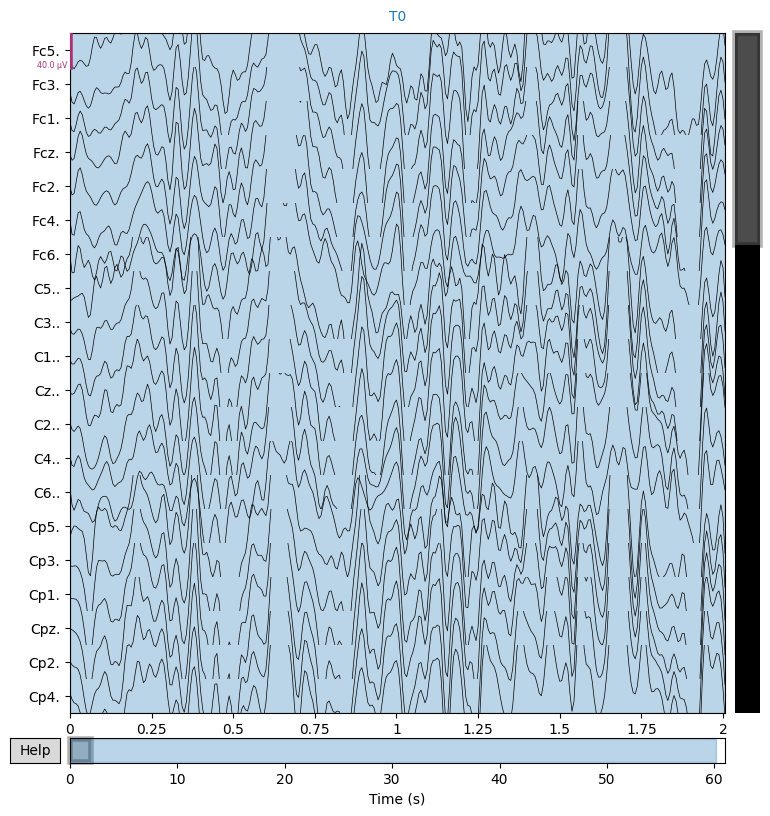

In [20]:
raw.plot(start=0,duration=2)

Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R02.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 9759  =      0.000 ...    60.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


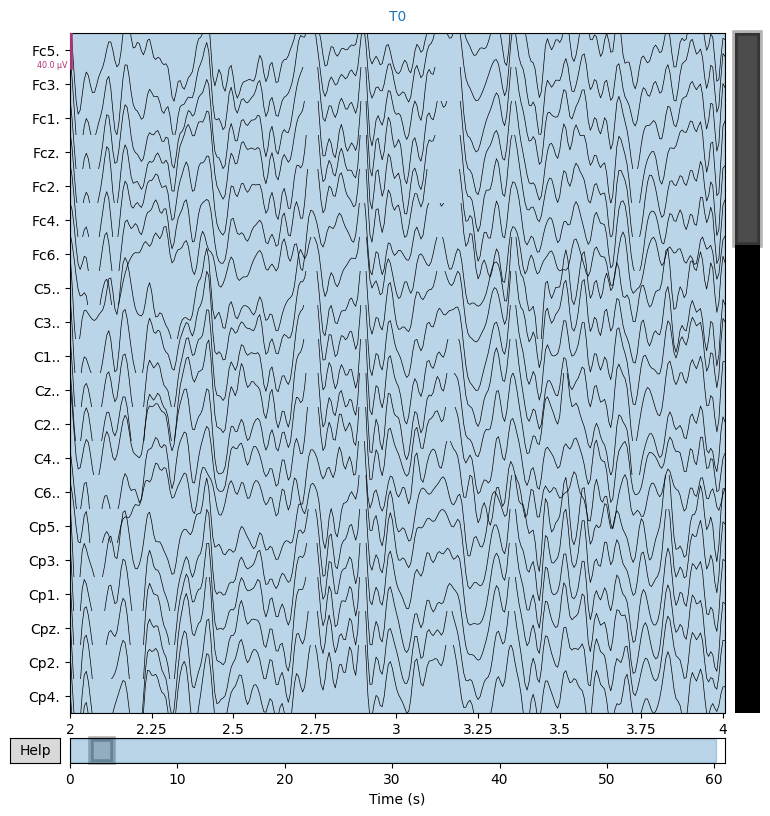

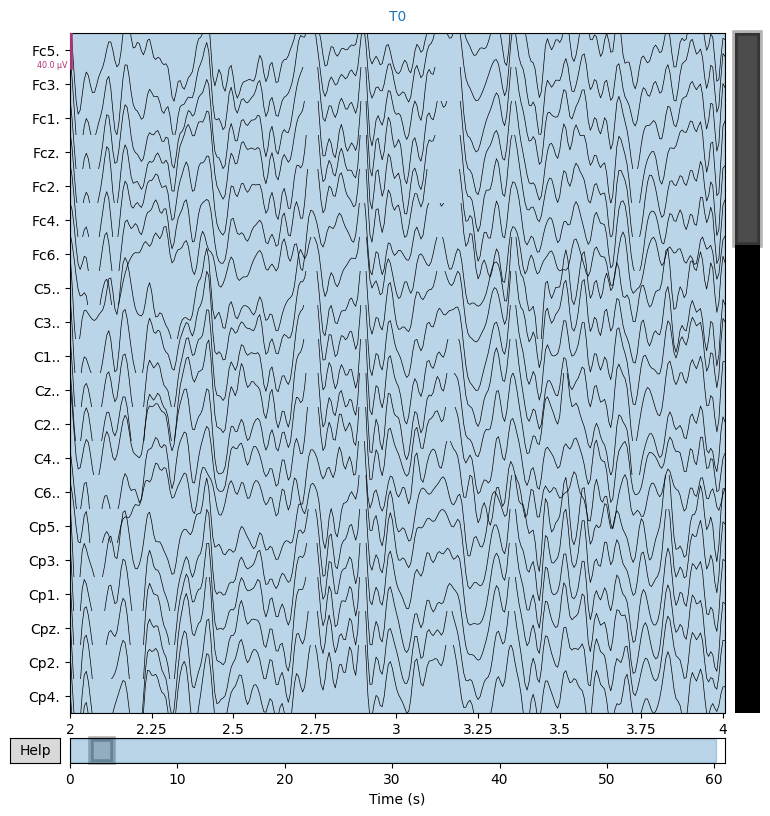

In [23]:

raw=mne.io.read_raw_edf(person_1_path_list[1],preload=True)
raw.filter(0.5,30)
raw.plot(start=2,duration=2)

In [24]:
data=raw.get_data()

In [26]:
pd.DataFrame(data)

<IPython.core.display.Javascript object>

,0,1,2,3,4,5,6,7,8,9,...,9750,9751,9752,9753,9754,9755,9756,9757,9758,9759
0,-4.658681e-21,-0.000009,-0.000012,-0.000008,-3.296119e-06,-0.000001,-0.000003,-0.000006,-8.739137e-06,-0.000008,...,1.493835e-06,1.324735e-06,1.158386e-06,9.918428e-07,8.274156e-07,6.642885e-07,4.997589e-07,3.347291e-07,1.694511e-07,6.776264e-21
1,-4.235165e-22,-0.000011,-0.000013,-0.000007,2.771950e-08,0.000001,-0.000003,-0.000010,-1.561745e-05,-0.000018,...,9.684395e-07,8.582396e-07,7.509625e-07,6.435763e-07,5.380036e-07,4.332141e-07,3.273231e-07,2.202865e-07,1.124870e-07,5.929231e-21
2,4.235165e-21,-0.000010,-0.000011,-0.000003,8.179456e-06,0.000013,0.000009,-0.000001,-1.150908e-05,-0.000016,...,6.222571e-07,5.509588e-07,4.823157e-07,4.135561e-07,3.465603e-07,2.803846e-07,2.131879e-07,1.443258e-07,7.439873e-08,-3.811648e-21
3,-5.082198e-21,-0.000007,-0.000005,0.000007,2.140026e-05,0.000028,0.000022,0.000011,5.389765e-07,-0.000005,...,1.679997e-07,1.474399e-07,1.294172e-07,1.114998e-07,9.530858e-08,7.955639e-08,6.313314e-08,4.435903e-08,2.434935e-08,-1.694066e-21
4,-2.541099e-21,-0.000010,-0.000008,0.000005,1.884618e-05,0.000022,0.000014,0.000003,-5.194700e-06,-0.000009,...,5.568031e-07,4.931139e-07,4.321567e-07,3.711173e-07,3.115764e-07,2.523778e-07,1.921557e-07,1.298779e-07,6.691769e-08,-8.470329e-22
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59,4.235165e-21,-0.000006,-0.000023,-0.000053,-8.454639e-05,-0.000111,-0.000131,-0.000141,-1.365907e-04,-0.000111,...,6.581943e-08,6.020089e-08,5.584284e-08,5.266035e-08,4.752684e-08,4.024454e-08,3.107771e-08,2.113309e-08,1.133842e-08,4.912791e-20
60,6.352747e-21,0.000015,0.000023,0.000017,-5.595563e-06,-0.000039,-0.000076,-0.000115,-1.548073e-04,-0.000190,...,3.552667e-07,3.169986e-07,2.811696e-07,2.466817e-07,2.115427e-07,1.741642e-07,1.342569e-07,9.221586e-08,4.786746e-08,-4.235165e-22
61,1.101143e-20,0.000030,0.000043,0.000030,-4.070922e-06,-0.000046,-0.000086,-0.000124,-1.591593e-04,-0.000184,...,7.080566e-07,6.290505e-07,5.524261e-07,4.776077e-07,4.021795e-07,3.246022e-07,2.451941e-07,1.653433e-07,8.444720e-08,2.371692e-20
62,-3.388132e-21,0.000013,0.000011,-0.000011,-5.048711e-05,-0.000098,-0.000147,-0.000191,-2.172794e-04,-0.000211,...,-3.655894e-07,-3.247363e-07,-2.808475e-07,-2.348790e-07,-1.902704e-07,-1.492867e-07,-1.110912e-07,-7.300548e-08,-3.503560e-08,0.000000e+00


In [31]:
events

array([[0, 0, 1]])

In [ ]:
raw

In [32]:
events, _ = mne.events_from_annotations(raw)

Used Annotations descriptions: ['T0']


In [33]:
raw=mne.io.read_raw_edf(person_1_path_list[3],preload=True)
from mne.preprocessing import ICA
raw.filter(0.5,30)

ica = ICA(n_components=20, random_state=42)  # Assuming 64 EEG channels

# Fit ICA
ica.fit(raw)
ica.apply(raw)


Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R04.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components


Measurement date,"August 12, 2009 16:15:00 GMT"
Experimenter,Unknown
Participant,X
Digitized points,Not available
Good channels,64 EEG
Bad channels,None
EOG channels,Not available
ECG channels,Not available
Sampling frequency,160.00 Hz
Highpass,0.50 Hz
Lowpass,30.00 Hz


In [34]:
events, _ = mne.events_from_annotations(raw)

Used Annotations descriptions: ['T0', 'T1', 'T2']


In [40]:
import mne
import numpy as np
from keras.preprocessing.sequence import pad_sequences

# Assuming you have already loaded the raw EEG data and extracted annotations
# raw = mne.io.read_raw_edf('your_file.edf')
# events, _ = mne.events_from_annotations(raw)

# Define event IDs for T0, T1, and T2
event_id = {'T0': 1, 'T1': 2, 'T2': 3}

# Extract event onsets for T0, T1, and T2 events
t0_events = events[events[:, 2] == event_id['T0']]
t1_events = events[events[:, 2] == event_id['T1']]
t2_events = events[events[:, 2] == event_id['T2']]

# Define segment duration (in samples) around each event onset
segment_duration = 1000 # for example, 1 second

# Initialize lists to store segmented EEG data
segmented_eeg_data_t0 = []
segmented_eeg_data_t1 = []
segmented_eeg_data_t2 = []

# Split EEG signal into segments around each event onset
for event in t0_events:
    onset_sample = event[0]
    segment_start = max(0, onset_sample - segment_duration // 2)
    segment_end = min(len(raw.times) - 1, onset_sample + segment_duration // 2)
    segment_data = raw.get_data()[:, segment_start:segment_end]
    segmented_eeg_data_t0.append(segment_data)

for event in t1_events:
    onset_sample = event[0]
    segment_start = max(0, onset_sample - segment_duration // 2)
    segment_end = min(len(raw.times) - 1, onset_sample + segment_duration // 2)
    segment_data = raw.get_data()[:, segment_start:segment_end]
    segmented_eeg_data_t1.append(segment_data)

for event in t2_events:
    onset_sample = event[0]
    segment_start = max(0, onset_sample - segment_duration // 2)
    segment_end = min(len(raw.times) - 1, onset_sample + segment_duration // 2)
    segment_data = raw.get_data()[:, segment_start:segment_end]
    segmented_eeg_data_t2.append(segment_data)

# Pad or truncate segments to ensure they all have the same length
segmented_eeg_data_t0_padded = pad_sequences(segmented_eeg_data_t0, maxlen=segment_duration, dtype='float32', padding='post', truncating='post')
segmented_eeg_data_t1_padded = pad_sequences(segmented_eeg_data_t1, maxlen=segment_duration, dtype='float32', padding='post', truncating='post')
segmented_eeg_data_t2_padded = pad_sequences(segmented_eeg_data_t2, maxlen=segment_duration, dtype='float32', padding='post', truncating='post')

# Convert padded segments to numpy arrays
segmented_eeg_data_t0_np = np.array(segmented_eeg_data_t0_padded)
segmented_eeg_data_t1_np = np.array(segmented_eeg_data_t1_padded)
segmented_eeg_data_t2_np = np.array(segmented_eeg_data_t2_padded)


ValueError: Shape of sample (1000,) of sequence at position 1 is different from expected shape (500,)

In [43]:
import mne

# Load the .edf file
raw = mne.io.read_raw_edf(person_1_path_list[3], preload=True)

# Convert annotations to events
events, event_dict = mne.events_from_annotations(raw)

# Define event IDs for t0, t1, t2 based on your annotation descriptions
# For example, if your annotations are like 't0', 't1', 't2'
event_id = {'t0': 1, 't1': 2, 't2': 3}

# Create epochs based on events
epochs = mne.Epochs(raw, events, event_id=event_id, tmin=-0.5, tmax=0.5, baseline=None, preload=True)

# Split epochs based on event markers
t0_epochs = epochs['t0']
t1_epochs = epochs['t1']
t2_epochs = epochs['t2']

# Save segmented epochs to separate files
t0_epochs.save('t0_epochs-epo.fif')
t1_epochs.save('t1_epochs-epo.fif')
t2_epochs.save('t2_epochs-epo.fif')


Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R04.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped


In [45]:
import mne

# Load the segmented EEG data
t0_epochs = mne.read_epochs('t0_epochs-epo.fif')
t1_epochs = mne.read_epochs('t1_epochs-epo.fif')
t2_epochs = mne.read_epochs('t2_epochs-epo.fif')

# Concatenate the epochs
all_epochs = mne.concatenate_epochs([t0_epochs, t1_epochs, t2_epochs])

# Get data array and events
data = all_epochs.get_data()
events = all_epochs.events

# Create a dictionary to hold data for each epoch
epoch_data = {}
for i, event in enumerate(events):
    event_id = event[2]
    if event_id not in epoch_data:
        epoch_data[event_id] = []
    epoch_data[event_id].append(data[i])

# Save each event type's data to a separate CSV file
for event_id, data_list in epoch_data.items():
    # Concatenate data for this event type along the first axis
    event_data = np.concatenate(data_list, axis=0)
    
    # Define the filename for this event type
    filename = f'event_{event_id}_data.csv'
    
    # Save the data to a CSV file
    np.savetxt(filename, event_data, delimiter=',')


Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
29 matching events found
No baseline correction 

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\893319055.py:9: RuntimeWarning: Concatenation of Annotations within Epochs is not supported yet. All annotations will be dropped.
  all_epochs = mne.concatenate_epochs([t0_epochs, t1_epochs, t2_epochs])
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\893319055.py:12: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = all_epochs.get_data()


In [ ]:
import mne
import numpy as np
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv1D, MaxPooling1D, Flatten, Dense

# Load the segmented EEG data from .fif files
t0_epochs = mne.read_epochs('t0_epochs-epo.fif')
t1_epochs = mne.read_epochs('t1_epochs-epo.fif')
t2_epochs = mne.read_epochs('t2_epochs-epo.fif')

# Concatenate all epochs and extract data
all_epochs = mne.concatenate_epochs([t0_epochs, t1_epochs, t2_epochs])
data = all_epochs.get_data()

# Create labels for each event type
labels = np.concatenate([
    np.zeros(len(t0_epochs)),
    np.ones(len(t1_epochs)),
    np.full(len(t2_epochs), 2)
])

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(data, labels, test_size=0.2, random_state=42)

# Define the deep learning model
model = Sequential([
    Conv1D(64, 3, activation='relu', input_shape=(X_train.shape[1], X_train.shape[2])),
    MaxPooling1D(2),
    Flatten(),
    Dense(64, activation='relu'),
    Dense(3, activation='softmax')
])

# Compile the model
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Train the model
model.fit(X_train, y_train, epochs=10, validation_data=(X_test, y_test))

# Evaluate the model
test_loss, test_acc = model.evaluate(X_test, y_test)
print('Test accuracy:', test_acc)


In [50]:
raw=mne.io.read_raw_edf(person_1_path_list[2],preload=True)
from mne.preprocessing import ICA
raw.filter(0.5,30)
# Create ICA object
ica = ICA(n_components=20, random_state=42)  # Assuming 64 EEG channels
ica.fit(raw)
ica.apply(raw)


Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.6s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components


Measurement date,"August 12, 2009 16:15:00 GMT"
Experimenter,Unknown
Participant,X
Digitized points,Not available
Good channels,64 EEG
Bad channels,None
EOG channels,Not available
ECG channels,Not available
Sampling frequency,160.00 Hz
Highpass,0.50 Hz
Lowpass,30.00 Hz


In [55]:
raw = mne.io.read_raw_edf(person_1_path_list[3], preload=True)
from mne.preprocessing import ICA
raw.filter(0.5,30)
ica = ICA(n_components=20, random_state=42) 
ica.apply(raw)

Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R04.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Applying ICA to Raw instance


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


TypeError: 'NoneType' object is not iterable

In [56]:
import mne
from mne.preprocessing import ICA
# Load the .edf file
raw = mne.io.read_raw_edf(person_1_path_list[3], preload=True)

raw.filter(0.5,30)
ica = ICA(n_components=20, random_state=42) 
ica.fit(raw)
ica.apply(raw)
events, event_dict = mne.events_from_annotations(raw)
event_id = {'t0': 1, 't1': 2, 't2': 3}
epochs = mne.Epochs(raw, events, event_id=event_id, tmin=-0.5, tmax=0.5, baseline=None, preload=True)
t0_epochs = epochs['t0']
t1_epochs = epochs['t1']
t2_epochs = epochs['t2']
t0_epochs.save('path_3_t0_epochs-epo.fif')
t1_epochs.save('path_3_t1_epochs-epo.fif')
t2_epochs.save('path_3_t2_epochs-epo.fif')


Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_data\S001\S001R04.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped


In [58]:
import mne
import numpy as np
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv1D, MaxPooling1D, Flatten, Dense

# Load the segmented EEG data from .fif files
t0_epochs = mne.read_epochs('path_3_t0_epochs-epo.fif')
t1_epochs = mne.read_epochs('path_3_t1_epochs-epo.fif')
t2_epochs = mne.read_epochs('path_3_t2_epochs-epo.fif')
all_epochs = mne.concatenate_epochs([t0_epochs, t1_epochs, t2_epochs])
data = all_epochs.get_data()

# Create labels for each event type
labels = np.concatenate([
    np.zeros(len(t0_epochs)),
    np.ones(len(t1_epochs)),
    np.full(len(t2_epochs), 2)
])

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(data, labels, test_size=0.2, random_state=42)

# Define the deep learning model
model = Sequential([
    Conv1D(64, 3, activation='relu', input_shape=(X_train.shape[1], X_train.shape[2])),
    MaxPooling1D(2),
    Flatten(),
    Dense(64, activation='relu'),
    Dense(3, activation='softmax')
])

# Compile the model
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Train the model
model.fit(X_train, y_train, epochs=10, validation_data=(X_test, y_test))

# Evaluate the model
test_loss, test_acc = model.evaluate(X_test, y_test)
print('Test accuracy:', test_acc)


Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\path_3_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\path_3_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\path_3_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
29 matching events found
No

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2654134524.py:11: RuntimeWarning: Concatenation of Annotations within Epochs is not supported yet. All annotations will be dropped.
  all_epochs = mne.concatenate_epochs([t0_epochs, t1_epochs, t2_epochs])
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2654134524.py:12: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = all_epochs.get_data()
c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:99: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(


Epoch 1/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - accuracy: 0.3913 - loss: 1.0986 - val_accuracy: 0.5000 - val_loss: 1.0977
Epoch 2/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - accuracy: 0.4783 - loss: 1.0977 - val_accuracy: 0.5000 - val_loss: 1.0956
Epoch 3/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - accuracy: 0.4783 - loss: 1.0958 - val_accuracy: 0.5000 - val_loss: 1.0932
Epoch 4/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step - accuracy: 0.4783 - loss: 1.0936 - val_accuracy: 0.5000 - val_loss: 1.0901
Epoch 5/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step - accuracy: 0.4783 - loss: 1.0909 - val_accuracy: 0.5000 - val_loss: 1.0865
Epoch 6/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step - accuracy: 0.4783 - loss: 1.0876 - val_accuracy: 0.5000 - val_loss: 1.0823
Epoch 7/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step - accuracy: 0.4783 - loss: 1.0837 - val_accuracy: 0.5000 - val_loss: 1.0775
Epoch 8/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step - accuracy: 0.4783 - loss: 1.0792 - val_accuracy: 0.5000 - val_loss: 1.072

In [ ]:
import mne
import numpy as np
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv1D, MaxPooling1D, Flatten, Dense

# List of individuals (assuming each individual has their own directory)
individuals = ['individual1', 'individual2', 'individual3']  # Add more individuals as needed

# List to hold EEG data and labels for all individuals
all_data = []
all_labels = []

# Loop through each individual
for individual in individuals:
    # Load segmented EEG data for this individual
    t0_epochs = mne.read_epochs(f'{individual}_t0_epochs-epo.fif')
    t1_epochs = mne.read_epochs(f'{individual}_t1_epochs-epo.fif')
    t2_epochs = mne.read_epochs(f'{individual}_t2_epochs-epo.fif')
    
    # Concatenate epochs for all event types
    all_epochs = mne.concatenate_epochs([t0_epochs, t1_epochs, t2_epochs])
    
    # Extract data and labels
    data = all_epochs.get_data()
    labels = np.concatenate([
        np.zeros(len(t0_epochs)),
        np.ones(len(t1_epochs)),
        np.full(len(t2_epochs), 2)
    ])
    
    # Append data and labels to the list
    all_data.append(data)
    all_labels.append(labels)

# Concatenate data and labels from all individuals
X = np.concatenate(all_data)
y = np.concatenate(all_labels)

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


model = Sequential([
    Conv1D(64, 3, activation='relu', input_shape=(X_train.shape[1], X_train.shape[2])),
    MaxPooling1D(2),
    Flatten(),
    Dense(64, activation='relu'),
    Dense(3, activation='softmax')
])

# Compile the model
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Train the model
model.fit(X_train, y_train, epochs=10, validation_data=(X_test, y_test))

# Evaluate the model
test_loss, test_acc = model.evaluate(X_test, y_test)
print('Test accuracy:', test_acc)


In [ ]:
import mne
from mne.preprocessing import ICA
# Load the .edf file
raw = mne.io.read_raw_edf(person_1_path_list[3], preload=True)

raw.filter(0.5,30)
ica = ICA(n_components=20, random_state=42) 
ica.fit(raw)
ica.apply(raw)
events, event_dict = mne.events_from_annotations(raw)
event_id = {'t0': 1, 't1': 2, 't2': 3}
epochs = mne.Epochs(raw, events, event_id=event_id, tmin=-0.5, tmax=0.5, baseline=None, preload=True)
t0_epochs = epochs['t0']
t1_epochs = epochs['t1']
t2_epochs = epochs['t2']
t0_epochs.save('path_3_t0_epochs-epo.fif')
t1_epochs.save('path_3_t1_epochs-epo.fif')
t2_epochs.save('path_3_t2_epochs-epo.fif')


In [ ]:
OPEN_CLOSE_LEFT_RIGHT_FIST=[3,7,11]

In [59]:
import os
import mne
from mne.preprocessing import ICA

eeg_data_folder = 'EEG_DATA'


for i in range(1, 81):
    individual_folder = f'S{i:03d}'
    individual_path = os.path.join(eeg_data_folder, individual_folder)
    
    # Check if the path is a directory
    if os.path.isdir(individual_path):
        # Create a folder to save individual's epochs
        individual_epochs_folder = f'Individual_{i:03d}'
        os.makedirs(individual_epochs_folder, exist_ok=True)
        
        # Iterate through the required EDF files for this individual
        for edf_file in [f'S{i:03d}R03.edf', f'S{i:03d}R07.edf', f'S{i:03d}R11.edf']:
            edf_file_path = os.path.join(individual_path, edf_file)
            
            # Load the .edf file
            raw = mne.io.read_raw_edf(edf_file_path, preload=True)
            raw.filter(0.5, 30)
            
            # Apply ICA
            ica = ICA(n_components=20, random_state=42) 
            ica.fit(raw)
            ica.apply(raw)
            
            # Extract epochs
            events, event_dict = mne.events_from_annotations(raw)
            event_id = {'t0': 1, 't1': 2, 't2': 3}
            epochs = mne.Epochs(raw, events, event_id=event_id, tmin=-0.5, tmax=0.5, baseline=None, preload=True)
            
            # Save epochs
            for epoch_type in ['t0', 't1', 't2']:
                epoch_type_epochs = epochs[epoch_type]
                individual_epoch_file_path = os.path.join(individual_epochs_folder, f'S{i:03d}_{edf_file[:-4]}_{epoch_type}_epochs-epo.fif')
                epoch_type_epochs.save(individual_epoch_file_path)


Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S001\S001R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.6s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S001\S001R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S001\S001R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.6s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S002\S002R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S002\S002R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S002\S002R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S003\S003R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 9.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S003\S003R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA to data using 64 channels (please be patient, this may take a while)
Selecting by number: 20 components
Fitting ICA took 4.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S003\S003R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S004\S004R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 8.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S004\S004R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA to data using 64 channels (please be patient, this may take a while)
Selecting by number: 20 components
Fitting ICA took 9.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S004\S004R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 15.1s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S005\S005R03.edf...
EDF file detected


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 11.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S005\S005R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 19.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S005\S005R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 2.0s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S006\S006R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 18.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S006\S006R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.2s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S006\S006R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S007\S007R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA to data using 64 channels (please be patient, this may take a while)
Selecting by number: 20 components
Fitting ICA took 5.3s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S007\S007R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.1s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S007\S007R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S008\S008R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 11.2s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S008\S008R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB st

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 18.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S008\S008R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.3s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S009\S009R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 12.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S009\S009R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB st

c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA to data using 64 channels (please be patient, this may take a while)
Selecting by number: 20 components
Fitting ICA took 13.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S009\S009R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 2.1s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S010\S010R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 11.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S010\S010R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)
Selecting by number: 20 components


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S010\S010R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.0s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S011\S011R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 10.1s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S011\S011R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB st

c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA to data using 64 channels (please be patient, this may take a while)
Selecting by number: 20 components
Fitting ICA took 8.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S011\S011R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain 

c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA to data using 64 channels (please be patient, this may take a while)
Selecting by number: 20 components
Fitting ICA took 4.1s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S012\S012R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 15.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S012\S012R07.edf...
EDF file detected


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S012\S012R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S013\S013R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S013\S013R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S013\S013R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.2s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S014\S014R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 5.3s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S014\S014R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 2.2s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S014\S014R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.0s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S015\S015R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 15.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S015\S015R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 7.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S015\S015R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S016\S016R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S016\S016R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S016\S016R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S017\S017R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.0s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S017\S017R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S017\S017R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S018\S018R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 16.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S018\S018R07.edf...


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 16.0s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S018\S018R11.edf...
EDF file detected


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S019\S019R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.0s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S019\S019R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S019\S019R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.0s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S020\S020R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 16.3s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S020\S020R07.edf...


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA to data using 64 channels (please be patient, this may take a while)
Selecting by number: 20 components
Fitting ICA took 11.3s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S020\S020R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain

c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA to data using 64 channels (please be patient, this may take a while)
Selecting by number: 20 components
Fitting ICA took 3.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S021\S021R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 9.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S021\S021R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Fitting ICA to data using 64 channels (please be patient, this may take a while)
Selecting by number: 20 components


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.6s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S021\S021R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S022\S022R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S022\S022R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S022\S022R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.6s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S023\S023R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.6s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S023\S023R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S023\S023R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S024\S024R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S024\S024R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S024\S024R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S025\S025R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.0s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S025\S025R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.0s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S025\S025R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA to data using 64 channels (please be patient, this may take a while)
Selecting by number: 20 components
Fitting ICA took 17.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S026\S026R03.edf...
EDF file detected


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 7.0s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S026\S026R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 11.2s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S026\S026R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB st

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 2.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S027\S027R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 17.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S027\S027R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S027\S027R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.3s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S028\S028R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 13.0s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S028\S028R07.edf...


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 2.6s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S028\S028R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.2s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S029\S029R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19839  =      0.000 ...   123.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S029\S029R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19839  =      0.000 ...   123.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA to data using 64 channels (please be patient, this may take a while)
Selecting by number: 20 components
Fitting ICA took 0.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S029\S029R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19839  =      0.000 ...   123.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.0s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S030\S030R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19839  =      0.000 ...   123.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Selecting by number: 20 components
Fitting ICA took 0.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S030\S030R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19839  =      0.000 ...   123.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.0s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S030\S030R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19839  =      0.000 ...   123.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S031\S031R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S031\S031R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S031\S031R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S032\S032R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S032\S032R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S032\S032R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S033\S033R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.6s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S033\S033R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S033\S033R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S034\S034R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.6s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S034\S034R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S034\S034R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 10.3s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S035\S035R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S035\S035R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.1s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S035\S035R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.6s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S036\S036R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S036\S036R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.0s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S036\S036R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA to data using 64 channels (please be patient, this may take a while)
Selecting by number: 20 components
Fitting ICA took 1.6s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S037\S037R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 18.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S037\S037R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S037\S037R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S038\S038R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.0s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S038\S038R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S038\S038R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S039\S039R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S039\S039R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S039\S039R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S040\S040R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S040\S040R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 12.0s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S040\S040R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 17.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S041\S041R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB st

c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA to data using 64 channels (please be patient, this may take a while)
Selecting by number: 20 components
Fitting ICA took 2.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S041\S041R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.6s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S041\S041R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.6s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S042\S042R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S042\S042R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S042\S042R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S043\S043R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 12.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S043\S043R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB st

c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA to data using 64 channels (please be patient, this may take a while)
Selecting by number: 20 components
Fitting ICA took 0.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S043\S043R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S044\S044R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S044\S044R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S044\S044R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.3s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S045\S045R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.6s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S045\S045R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S045\S045R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S046\S046R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S046\S046R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S046\S046R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.6s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S047\S047R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 9.1s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S047\S047R07.edf...
EDF file detected


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 5.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S047\S047R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S048\S048R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S048\S048R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.3s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S048\S048R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S049\S049R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 12.1s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S049\S049R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)
Selecting by number: 20 components


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S049\S049R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S050\S050R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 8.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S050\S050R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.6s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S050\S050R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S051\S051R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 8.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S051\S051R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA to data using 64 channels (please be patient, this may take a while)
Selecting by number: 20 components
Fitting ICA took 8.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S051\S051R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain 

c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA to data using 64 channels (please be patient, this may take a while)
Selecting by number: 20 components
Fitting ICA took 1.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S052\S052R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 17.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S052\S052R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S052\S052R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.2s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S053\S053R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S053\S053R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S053\S053R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.1s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S054\S054R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 3.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S054\S054R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA to data using 64 channels (please be patient, this may take a while)
Selecting by number: 20 components
Fitting ICA took 18.0s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S054\S054R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S055\S055R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 18.2s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S055\S055R07.edf...
EDF file detected
Setting channel info structure...


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S055\S055R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.2s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S056\S056R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S056\S056R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S056\S056R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S057\S057R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 14.3s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S057\S057R07.edf...
EDF file detected


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.3s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S057\S057R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S058\S058R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 17.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S058\S058R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 9.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S058\S058R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA to data using 64 channels (please be patient, this may take a while)
Selecting by number: 20 components
Fitting ICA took 9.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S059\S059R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain 

c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA to data using 64 channels (please be patient, this may take a while)
Selecting by number: 20 components
Fitting ICA took 0.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S059\S059R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 1.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S059\S059R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S060\S060R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S060\S060R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S060\S060R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 1.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S061\S061R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.6s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S061\S061R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S061\S061R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S062\S062R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S062\S062R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 10.0s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S062\S062R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB st

c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA to data using 64 channels (please be patient, this may take a while)
Selecting by number: 20 components
Fitting ICA took 0.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S063\S063R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S063\S063R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S063\S063R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S064\S064R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 9.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S064\S064R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA to data using 64 channels (please be patient, this may take a while)
Selecting by number: 20 components
Fitting ICA took 7.6s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S064\S064R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S065\S065R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 17.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S065\S065R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 18.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S065\S065R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 3.1s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S066\S066R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.6s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S066\S066R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.2s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S066\S066R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.0s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S067\S067R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S067\S067R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.6s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S067\S067R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S068\S068R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.6s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S068\S068R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S068\S068R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S069\S069R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S069\S069R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 8.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S069\S069R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.3s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S070\S070R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 1.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S070\S070R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S070\S070R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.3s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S071\S071R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.3s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S071\S071R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S071\S071R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S072\S072R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.3s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S072\S072R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S072\S072R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.2s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S073\S073R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S073\S073R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S073\S073R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S074\S074R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 3.1s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S074\S074R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 12.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S074\S074R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB st

c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S075\S075R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 16.6s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S075\S075R07.edf...
EDF file detected
Setting channel info structure...


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S075\S075R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S076\S076R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 12.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S076\S076R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB st

c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S076\S076R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 0.3s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S077\S077R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Fitting ICA took 3.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S077\S077R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 16.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S077\S077R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 16.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S078\S078R03.edf...


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 2.6s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S078\S078R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.2s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S078\S078R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S079\S079R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 16.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S079\S079R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 0.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S079\S079R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 1.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S080\S080R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 16.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S080\S080R07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 1057 samples (6.606 s)

Fitting ICA to data using 64 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 2.0s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped
Extracting EDF parameters from d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\EEG_DATA\S080\S080R11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19679  =      0.000 ...   122.994 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB sto

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


Selecting by number: 20 components
Fitting ICA took 16.1s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 161 original time points ...
1 bad epochs dropped


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\decomposition\_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


In [61]:
import os
os.listdir("Individual_001")

['S001_S001R03_t0_epochs-epo.fif',
 'S001_S001R03_t1_epochs-epo.fif',
 'S001_S001R03_t2_epochs-epo.fif',
 'S001_S001R07_t0_epochs-epo.fif',
 'S001_S001R07_t1_epochs-epo.fif',
 'S001_S001R07_t2_epochs-epo.fif',
 'S001_S001R11_t0_epochs-epo.fif',
 'S001_S001R11_t1_epochs-epo.fif',
 'S001_S001R11_t2_epochs-epo.fif']

In [68]:
import os
from tensorflow.keras.layers import Dropout


train_data = []
train_labels = []


test_data = []
test_labels = []


for i in range(1, 71):
    individual_folder_path = f"Individual_{i:03}"
  
    individual_data = []
    individual_labels = []
 
    for file in os.listdir(individual_folder_path):
        if file.endswith('.fif'):
            
            epochs = mne.read_epochs(os.path.join(individual_folder_path, file))
        
            data = epochs.get_data()
            labels = np.full(len(epochs), int(file.split('_')[-2][-1]))  
            
            individual_data.append(data)
            individual_labels.append(labels)

    X_individual = np.concatenate(individual_data)
    y_individual = np.concatenate(individual_labels)
  
    train_data.append(X_individual)
    train_labels.append(y_individual)


for i in range(71, 81):
    individual_folder_path = f"Individual_{i:03}"
   
    individual_data = []
    individual_labels = []
    
    for file in os.listdir(individual_folder_path):
        if file.endswith('.fif'):
           
            epochs = mne.read_epochs(os.path.join(individual_folder_path, file))
            # Extract data and labels
            data = epochs.get_data()
            labels = np.full(len(epochs), int(file.split('_')[-2][-1]))  # Extract label from file name
            
            individual_data.append(data)
            individual_labels.append(labels)

    X_individual = np.concatenate(individual_data)
    y_individual = np.concatenate(individual_labels)
    
    test_data.append(X_individual)
    test_labels.append(y_individual)


X_train = np.concatenate(train_data)
y_train = np.concatenate(train_labels)


X_test = np.concatenate(test_data)
y_test = np.concatenate(test_labels)


Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_001\S001_S001R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_001\S001_S001R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_001\S001_S001R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection i

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_001\S001_S001R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_001\S001_S001R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated


C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_001\S001_S001R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_002\S002_S002R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_002\S002_S002R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection i

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_002\S002_S002R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_002\S002_S002R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_002\S002_S002R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_002\S002_S002R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_002\S002_S002R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_003\S003_S003R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_003\S003_S003R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_003\S003_S003R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_003\S003_S003R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_003\S003_S003R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_003\S003_S003R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_004\S004_S004R03_t0_epochs-epo.fif ...
Iso

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_004\S004_S004R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_004\S004_S004R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_004\S004_S004R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available


C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_004\S004_S004R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_004\S004_S004R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_004\S004_S004R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_005\S005_S005R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_005\S005_S005R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_005\S005_S005R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matchin

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_005\S005_S005R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_005\S005_S005R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_005\S005_S005R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_006\S006_S006R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_006\S006_S006R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_006\S006_S006R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_006\S006_S006R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_006\S006_S006R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_006\S006_S006R11_t2_epochs-epo.fif ...
Isotrak not found


C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_007\S007_S007R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_007\S007_S007R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_007\S007_S007R03_t2_epochs-epo.fif ...
Iso

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_007\S007_S007R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_007\S007_S007R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_007\S007_S007R11_t0_epochs-epo.fif ...
Iso

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_007\S007_S007R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_008\S008_S008R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_008\S008_S008R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the dat

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_008\S008_S008R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_008\S008_S008R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata


C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_008\S008_S008R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_008\S008_S008R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_008\S008_S008R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_009\S009_S009R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_009\S009_S009R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_009\S009_S009R07_t0_epoc

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_009\S009_S009R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_009\S009_S009R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_010\S010_S010R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_010\S010_S010R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_010\S010_S010R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_010\S010_S010R11_t0_epochs-epo.fif ...
Iso

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_010\S010_S010R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_010\S010_S010R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_011\S011_S011R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline corr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_011\S011_S011R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_011\S011_S011R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_011\S011_S011R07_t2_epochs-epo.fif ...
Iso

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_011\S011_S011R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_011\S011_S011R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_012\S012_S012R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_012\S012_S012R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_012\S012_S012R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_012\S012_S012R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the dat

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_012\S012_S012R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_013\S013_S013R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_013\S013_S013R03_t1_epoc

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_013\S013_S013R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_013\S013_S013R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_013\S013_S013R07_t1_epochs-epo.fif ...
Iso

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_013\S013_S013R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_013\S013_S013R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_013\S013_S013R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection i

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_014\S014_S014R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_014\S014_S014R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_014\S014_S014R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_014\S014_S014R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_014\S014_S014R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_014\S014_S014R11_t2_epochs-epo.fif ...
Iso

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_015\S015_S015R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_015\S015_S015R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_015\S015_S015R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_015\S015_S015R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_015\S015_S015R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_016\S016_S016R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_016\S016_S016R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_016\S016_S016R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_016\S016_S016R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_016\S016_S016R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_016\S016_S016R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_016\S016_S016R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_017\S017_S017R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_017\S017_S017R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_017\S017_S017R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the dat

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_017\S017_S017R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_017\S017_S017R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_017\S017_S017R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_017\S017_S017R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_018\S018_S018R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_018\S018_S018R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline corr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_018\S018_S018R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_018\S018_S018R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_018\S018_S018R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_018\S018_S018R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_018\S018_S018R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_019\S019_S019R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_019\S019_S019R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_019\S019_S019R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_019\S019_S019R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found


C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_019\S019_S019R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_019\S019_S019R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_019\S019_S019R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matchin

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_020\S020_S020R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_020\S020_S020R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_020\S020_S020R07_t1_epochs-epo.fif ...
Iso

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_020\S020_S020R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_020\S020_S020R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_021\S021_S021R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_021\S021_S021R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_021\S021_S021R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_021\S021_S021R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection i

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_021\S021_S021R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_021\S021_S021R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_022\S022_S022R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_022\S022_S022R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_022\S022_S022R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_022\S022_S022R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline corr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_022\S022_S022R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_022\S022_S022R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_022\S022_S022R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_023\S023_S023R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_023\S023_S023R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_023\S023_S023R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline corr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_023\S023_S023R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_023\S023_S023R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_023\S023_S023R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline corr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_024\S024_S024R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_024\S024_S024R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_024\S024_S024R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata


C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_024\S024_S024R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_024\S024_S024R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_024\S024_S024R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_025\S025_S025R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_025\S025_S025R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_025\S025_S025R07_t0_epochs-epo.fif ...
Iso

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_025\S025_S025R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_025\S025_S025R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_025\S025_S025R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection i

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_026\S026_S026R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_026\S026_S026R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_026\S026_S026R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_026\S026_S026R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_026\S026_S026R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_026\S026_S026R11_t2_epoc

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_027\S027_S027R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_027\S027_S027R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_027\S027_S027R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_027\S027_S027R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_027\S027_S027R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_027\S027_S027R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline corr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_028\S028_S028R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_028\S028_S028R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_028\S028_S028R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection i

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_028\S028_S028R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_028\S028_S028R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_028\S028_S028R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection i

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_029\S029_S029R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_029\S029_S029R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_029\S029_S029R03_t2_epoc

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_029\S029_S029R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_029\S029_S029R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_029\S029_S029R07_t2_epoc

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_030\S030_S030R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_030\S030_S030R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_030\S030_S030R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the dat

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_030\S030_S030R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_030\S030_S030R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_030\S030_S030R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_031\S031_S031R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_031\S031_S031R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_031\S031_S031R03_t2_epochs-epo.fif ...
Iso

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_031\S031_S031R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_031\S031_S031R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_031\S031_S031R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline corr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_031\S031_S031R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_032\S032_S032R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_032\S032_S032R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matchin

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_032\S032_S032R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_032\S032_S032R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_032\S032_S032R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection i

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_032\S032_S032R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_033\S033_S033R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_033\S033_S033R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_033\S033_S033R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_033\S033_S033R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_033\S033_S033R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_034\S034_S034R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_034\S034_S034R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_034\S034_S034R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_034\S034_S034R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_034\S034_S034R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_034\S034_S034R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection i

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_035\S035_S035R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_035\S035_S035R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_035\S035_S035R07_t0_epochs-epo.fif ...
Iso

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_035\S035_S035R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_035\S035_S035R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_035\S035_S035R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the dat

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_036\S036_S036R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_036\S036_S036R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_036\S036_S036R07_t0_epochs-epo.fif ...
Iso

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_036\S036_S036R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_036\S036_S036R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_036\S036_S036R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_037\S037_S037R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_037\S037_S037R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_037\S037_S037R07_t0_epoc

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_037\S037_S037R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_037\S037_S037R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_037\S037_S037R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_038\S038_S038R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_038\S038_S038R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_038\S038_S038R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_038\S038_S038R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_038\S038_S038R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_038\S038_S038R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_039\S039_S039R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_039\S039_S039R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_039\S039_S039R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline corr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_039\S039_S039R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_039\S039_S039R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_039\S039_S039R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_040\S040_S040R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_040\S040_S040R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_040\S040_S040R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_040\S040_S040R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_040\S040_S040R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_040\S040_S040R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_040\S040_S040R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_041\S041_S041R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_041\S041_S041R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_041\S041_S041R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_041\S041_S041R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied


C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_041\S041_S041R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_041\S041_S041R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_041\S041_S041R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline corr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_042\S042_S042R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_042\S042_S042R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_042\S042_S042R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_042\S042_S042R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_042\S042_S042R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_042\S042_S042R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_043\S043_S043R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_043\S043_S043R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found


C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_043\S043_S043R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_043\S043_S043R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_043\S043_S043R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matchin

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_043\S043_S043R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_043\S043_S043R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_044\S044_S044R03_t0_epochs-epo.fif ...
Iso

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_044\S044_S044R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_044\S044_S044R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_044\S044_S044R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matchin

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_044\S044_S044R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_044\S044_S044R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_044\S044_S044R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available


C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_045\S045_S045R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_045\S045_S045R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_045\S045_S045R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_045\S045_S045R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_045\S045_S045R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_045\S045_S045R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_045\S045_S045R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_046\S046_S046R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_046\S046_S046R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_046\S046_S046R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_046\S046_S046R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_046\S046_S046R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_046\S046_S046R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_046\S046_S046R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_047\S047_S047R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matchin

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_047\S047_S047R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_047\S047_S047R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_047\S047_S047R07_t1_epochs-epo.fif ...
Isotrak not found


C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_047\S047_S047R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_047\S047_S047R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_047\S047_S047R11_t1_epochs-epo.fif ...
Iso

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_047\S047_S047R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_048\S048_S048R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found


C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_048\S048_S048R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_048\S048_S048R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_048\S048_S048R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matchin

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_048\S048_S048R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_048\S048_S048R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_048\S048_S048R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline corr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_049\S049_S049R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_049\S049_S049R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_049\S049_S049R03_t2_epoc

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_049\S049_S049R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_049\S049_S049R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_049\S049_S049R11_t1_epoc

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_049\S049_S049R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_050\S050_S050R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_050\S050_S050R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_050\S050_S050R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_050\S050_S050R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_050\S050_S050R11_t0_epoc

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_051\S051_S051R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_051\S051_S051R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_051\S051_S051R03_t2_epoc

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_051\S051_S051R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_051\S051_S051R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_051\S051_S051R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_052\S052_S052R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_052\S052_S052R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_052\S052_S052R03_t2_epoc

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_052\S052_S052R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_052\S052_S052R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_052\S052_S052R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the dat

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_052\S052_S052R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_053\S053_S053R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_053\S053_S053R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_053\S053_S053R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_053\S053_S053R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_053\S053_S053R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the dat

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_054\S054_S054R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_054\S054_S054R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_054\S054_S054R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_054\S054_S054R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_054\S054_S054R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_054\S054_S054R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_055\S055_S055R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_055\S055_S055R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_055\S055_S055R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the dat

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_055\S055_S055R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_055\S055_S055R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_055\S055_S055R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found


C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_055\S055_S055R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_055\S055_S055R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_056\S056_S056R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matchin

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_056\S056_S056R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_056\S056_S056R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_056\S056_S056R11_t0_epoc

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_056\S056_S056R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_057\S057_S057R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_057\S057_S057R03_t1_epochs-epo.fif ...
Isotrak not found


C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_057\S057_S057R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_057\S057_S057R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_057\S057_S057R07_t1_epochs-epo.fif ...
Iso

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_057\S057_S057R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_057\S057_S057R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_058\S058_S058R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata


C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_058\S058_S058R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_058\S058_S058R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_058\S058_S058R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_058\S058_S058R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_058\S058_S058R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_058\S058_S058R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found


C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_059\S059_S059R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_059\S059_S059R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_059\S059_S059R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matchin

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_059\S059_S059R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_059\S059_S059R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_059\S059_S059R11_t1_epochs-epo.fif ...
Iso

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_060\S060_S060R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_060\S060_S060R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_060\S060_S060R07_t0_epochs-epo.fif ...


C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_060\S060_S060R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_060\S060_S060R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_060\S060_S060R11_t0_epoc

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_061\S061_S061R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_061\S061_S061R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_061\S061_S061R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata


C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_061\S061_S061R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_061\S061_S061R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_061\S061_S061R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_061\S061_S061R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_062\S062_S062R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_062\S062_S062R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available


C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_062\S062_S062R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_062\S062_S062R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_062\S062_S062R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_062\S062_S062R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_063\S063_S063R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_063\S063_S063R03_t1_epochs-epo.fif ...
Iso

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_063\S063_S063R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_063\S063_S063R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_063\S063_S063R07_t2_epochs-epo.fif ...
Iso

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_063\S063_S063R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_063\S063_S063R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_063\S063_S063R11_t2_epochs-epo.fif ...
Iso

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_064\S064_S064R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_064\S064_S064R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_064\S064_S064R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_064\S064_S064R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_064\S064_S064R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_064\S064_S064R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection i

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_065\S065_S065R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_065\S065_S065R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_065\S065_S065R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matchin

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_065\S065_S065R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_065\S065_S065R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_065\S065_S065R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline corr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_065\S065_S065R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_066\S066_S066R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_066\S066_S066R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection i

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_066\S066_S066R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_066\S066_S066R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_066\S066_S066R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_066\S066_S066R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_066\S066_S066R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_067\S067_S067R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_067\S067_S067R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_067\S067_S067R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_067\S067_S067R07_t2_epochs-epo.fif ...


C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_067\S067_S067R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_067\S067_S067R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_067\S067_S067R11_t2_epoc

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_068\S068_S068R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_068\S068_S068R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_068\S068_S068R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matchin

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_068\S068_S068R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_068\S068_S068R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_068\S068_S068R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matchin

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_069\S069_S069R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_069\S069_S069R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_069\S069_S069R07_t2_epochs-epo.fif ...
Iso

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_070\S070_S070R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_070\S070_S070R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_070\S070_S070R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matchin

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_070\S070_S070R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_070\S070_S070R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_070\S070_S070R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matchin

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_071\S071_S071R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_071\S071_S071R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_071\S071_S071R03_t2_epochs-epo.fif ...
Iso

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:24: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_071\S071_S071R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_071\S071_S071R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_071\S071_S071R07_t2_epochs-epo.fif ...
Iso

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_072\S072_S072R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_072\S072_S072R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_072\S072_S072R03_t2_epoc

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_072\S072_S072R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_072\S072_S072R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_072\S072_S072R11_t2_epoc

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_073\S073_S073R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_073\S073_S073R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_073\S073_S073R07_t0_epoc

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_073\S073_S073R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_073\S073_S073R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_073\S073_S073R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_074\S074_S074R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_074\S074_S074R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_074\S074_S074R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection i

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_074\S074_S074R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_074\S074_S074R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_075\S075_S075R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline corr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_075\S075_S075R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_075\S075_S075R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_075\S075_S075R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_076\S076_S076R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_076\S076_S076R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_076\S076_S076R07_t1_epochs-epo.fif ...
Iso

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_076\S076_S076R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_076\S076_S076R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_076\S076_S076R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not se

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_077\S077_S077R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_077\S077_S077R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_077\S077_S077R07_t1_epoc

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_078\S078_S078R03_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_078\S078_S078R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_078\S078_S078R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_078\S078_S078R07_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_078\S078_S078R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_078\S078_S078R11_t1_epoc

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_079\S079_S079R03_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_079\S079_S079R03_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_079\S079_S079R07_t0_epochs-epo.fif ...
Iso

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_079\S079_S079R11_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_079\S079_S079R11_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_079\S079_S079R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline corr

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_080\S080_S080R07_t0_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_080\S080_S080R07_t1_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_080\S080_S080R07_t2_epochs-epo.fif ...
Iso

C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\A

Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated
Reading d:\DATA_SCIENCE_PROJECTS)ALL\phsiolab\Individual_080\S080_S080R11_t2_epochs-epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
7 matching events found
No baseline correction applied
0 projection items activated


C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()
C:\Users\Charanjeet Juneja\AppData\Local\Temp\ipykernel_3560\2986316056.py:48: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  data = epochs.get_data()


c:\Users\Charanjeet Juneja\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:99: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(


Epoch 1/100 - Test accuracy: 0.6828
Epoch 2/100 - Test accuracy: 0.6828
Epoch 3/100 - Test accuracy: 0.6828
Epoch 4/100 - Test accuracy: 0.6828
Epoch 5/100 - Test accuracy: 0.6828
Epoch 6/100 - Test accuracy: 0.6828
Epoch 7/100 - Test accuracy: 0.6828
Epoch 8/100 - Test accuracy: 0.6885
Epoch 9/100 - Test accuracy: 0.6966
Epoch 10/100 - Test accuracy: 0.7046
Epoch 11/100 - Test accuracy: 0.7069
Epoch 12/100 - Test accuracy: 0.7023
Epoch 13/100 - Test accuracy: 0.7046
Epoch 14/100 - Test accuracy: 0.7057
Epoch 15/100 - Test accuracy: 0.7046
Epoch 16/100 - Test accuracy: 0.7126
Epoch 17/100 - Test accuracy: 0.7310
Epoch 18/100 - Test accuracy: 0.7207
Epoch 19/100 - Test accuracy: 0.7184
Epoch 20/100 - Test accuracy: 0.7310
Epoch 21/100 - Test accuracy: 0.7379
Epoch 22/100 - Test accuracy: 0.7391
Epoch 23/100 - Test accuracy: 0.7230
Epoch 24/100 - Test accuracy: 0.7552
Epoch 25/100 - Test accuracy: 0.7437
Epoch 26/100 - Test accuracy: 0.7437
Epoch 27/100 - Test accuracy: 0.7425
Epoch 28/1

Epoch 1/100 - Test accuracy: 49.00
Epoch 2/100 - Test accuracy: 49.73
Epoch 3/100 - Test accuracy: 50.47
Epoch 4/100 - Test accuracy: 51.20
Epoch 5/100 - Test accuracy: 51.94
Epoch 6/100 - Test accuracy: 52.67
Epoch 7/100 - Test accuracy: 53.41
Epoch 8/100 - Test accuracy: 54.14
Epoch 9/100 - Test accuracy: 54.88
Epoch 10/100 - Test accuracy: 55.61
Epoch 11/100 - Test accuracy: 56.35
Epoch 12/100 - Test accuracy: 57.08
Epoch 13/100 - Test accuracy: 57.82
Epoch 14/100 - Test accuracy: 58.55
Epoch 15/100 - Test accuracy: 59.29
Epoch 16/100 - Test accuracy: 60.02
Epoch 17/100 - Test accuracy: 60.76
Epoch 18/100 - Test accuracy: 61.49
Epoch 19/100 - Test accuracy: 62.22
Epoch 20/100 - Test accuracy: 62.96
Epoch 21/100 - Test accuracy: 63.69
Epoch 22/100 - Test accuracy: 64.43
Epoch 23/100 - Test accuracy: 65.16
Epoch 24/100 - Test accuracy: 65.90


KeyboardInterrupt: 

In [71]:
import os
import numpy as np
from tensorflow.keras.layers import Dropout
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv1D, MaxPooling1D, Flatten, Dense


start_epoch = 1
end_epoch = 30



model = Sequential([
    Conv1D(64, 3, activation='relu', input_shape=(X_train.shape[1], X_train.shape[2])),
    MaxPooling1D(2),
    Conv1D(128, 3, activation='relu'),
    MaxPooling1D(2),
    Conv1D(256, 3, activation='relu'),
    MaxPooling1D(2),
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.5),  
    Dense(64, activation='relu'),
    Dense(3, activation='softmax')
])
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])


epochs = 30
for epoch in range(epochs):
    model.fit(X_train, y_train, epochs=1, verbose=0)

    print(f'Epoch {epoch+1}/{epochs} - Test accuracy: {acc:.2f}')


Epoch 1/30 - Test accuracy: 49.00
Epoch 2/30 - Test accuracy: 50.24
Epoch 3/30 - Test accuracy: 51.48
Epoch 4/30 - Test accuracy: 52.72
Epoch 5/30 - Test accuracy: 53.97
Epoch 6/30 - Test accuracy: 55.21
Epoch 7/30 - Test accuracy: 56.45
Epoch 8/30 - Test accuracy: 57.69
Epoch 9/30 - Test accuracy: 58.93
Epoch 10/30 - Test accuracy: 60.17
Epoch 11/30 - Test accuracy: 61.41
Epoch 12/30 - Test accuracy: 62.66
Epoch 13/30 - Test accuracy: 63.90
Epoch 14/30 - Test accuracy: 65.14
Epoch 15/30 - Test accuracy: 66.38
Epoch 16/30 - Test accuracy: 67.62
Epoch 17/30 - Test accuracy: 68.86
Epoch 18/30 - Test accuracy: 70.10
Epoch 19/30 - Test accuracy: 71.34
Epoch 20/30 - Test accuracy: 72.59
Epoch 21/30 - Test accuracy: 73.83
Epoch 22/30 - Test accuracy: 75.07
Epoch 23/30 - Test accuracy: 76.31
Epoch 24/30 - Test accuracy: 77.55
Epoch 25/30 - Test accuracy: 78.79
Epoch 26/30 - Test accuracy: 80.03
Epoch 27/30 - Test accuracy: 81.28
Epoch 28/30 - Test accuracy: 82.52
Epoch 29/30 - Test accuracy: 

In [72]:

model.save("eeg_model.h5")
